<a href="https://colab.research.google.com/github/shelbybachman/neuromatch-academy-2021/blob/main/NMA_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [5]:
# code for NMA 2021 project
# written by shelby bachman, last updated 2021-07-20
# some pieces adapted from https://colab.research.google.com/drive/1pTU7TLA1me4nvoZI8-8rHMH-0BlmktJ9#scrollTo=sZwgMo5Id_ZG

# Setup

In [6]:
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import pandas as pd
import seaborn as sns
import scipy
from scipy.stats import zscore
from scipy.stats import gamma
from scipy import stats
import sklearn
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score
!pip install nltools --quiet
from nltools.file_reader import onsets_to_dm
from nltools.external import glover_hrf
!pip install nilearn --quiet
from nilearn import plotting, datasets

     |████████████████████████████████| 3.3 MB 9.1 MB/s 
     |████████████████████████████████| 4.9 MB 60.4 MB/s 


/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm
/usr/local/lib/python3.7/dist-packages/nilearn/datasets/__init__.py:89: FutureWarning: Fetchers from the nilearn.datasets module will be updated in version 0.9 to return python strings instead of bytes and Pandas dataframes instead of Numpy arrays.
  "Numpy arrays.", FutureWarning)


In [7]:
# figure settings
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
#plt.style.use('default')
plt.style.use("https://raw.githubusercontent.com/NeuromatchAcademy/course-content/master/nma.mplstyle")



### Download parcellated HCP gambling task data

The HCP dataset comprises task-based fMRI from a large sample of human subjects. The NMA-curated dataset includes time series data that has been preprocessed and spatially-downsampled by aggregating within 360 regions of interest.

In order to use this dataset, please electronically sign the HCP data use terms at [ConnectomeDB](https://db.humanconnectome.org). Instructions for this are on pp. 24-25 of the [HCP Reference Manual](https://www.humanconnectome.org/storage/app/media/documentation/s1200/HCP_S1200_Release_Reference_Manual.pdf).

Below, we download the data:

In [8]:
# The download cells will store the data in nested directories starting here:
HCP_DIR = "./hcp"
if not os.path.isdir(HCP_DIR):
  os.mkdir(HCP_DIR)

# The data shared for NMA projects is a subset of the full HCP dataset
N_SUBJECTS = 339

# The data have already been aggregated into ROIs from the Glasser parcellation
N_PARCELS = 360

# The acquisition parameters for all tasks were identical
TR = 0.72  # Time resolution, in seconds

# The parcels are matched across hemispheres with the same order
HEMIS = ["Right", "Left"]

# Each experiment was repeated twice in each subject
N_RUNS = 2

# We use gambling task data only
EXPERIMENTS = {
    # the NMA gambling task data includes 5 types of EV files (see HCP reference manual):
    # win.txt: onset of mostly reward blocks
    # loss.txt: onset of mostly loss blocks
    # win_event.txt: onset of reward trials
    # loss_event.txt: onset of reward trials
    # neut_event.txt: onset of neutral trials 
    'GAMBLING'   : {'runs': [11,12], 'cond':['loss_event','win_event','neut_event','loss','win']}
}

# You may want to limit the subjects used during code development.
# This will use all subjects:
subjects = range(N_SUBJECTS)


In [9]:
fname = "hcp_task.tgz"
if not os.path.exists(fname):
  !wget -qO $fname https://osf.io/s4h8j/download/
  !tar -xzf $fname -C $HCP_DIR --strip-components=1

> For a detailed description of the tasks have a look pages 45-54 of the [HCP reference manual](https://www.humanconnectome.org/storage/app/media/documentation/s1200/HCP_S1200_Release_Reference_Manual.pdf).

## Load region information

Downloading this dataset will create the `regions.npy` file, which contains the region name and network assignment for each parcel.

Detailed information about the name used for each region is provided [in the Supplement](https://static-content.springer.com/esm/art%3A10.1038%2Fnature18933/MediaObjects/41586_2016_BFnature18933_MOESM330_ESM.pdf) to [Glasser et al. 2016](https://www.nature.com/articles/nature18933).

Information about the network parcellation is provided in [Ji et al, 2019](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6289683/).



In [10]:
regions = np.load(f"{HCP_DIR}/regions.npy").T
region_info = dict(
    name=regions[0].tolist(),
    network=regions[1],
    hemi=['Right']*int(N_PARCELS/2) + ['Left']*int(N_PARCELS/2),
)

## Functions

Here we define a few functions that we will call below.

- `load_single_timeseries()`: loads timeseries from a given subject, task and run
- `load_evs()`: loads an EV file for a given subject, task and run
- `average_frames()`: average all frames from a given condition

In [11]:
def load_single_timeseries(subject, experiment, run, remove_mean=True):
  """Load timeseries data for a single subject and single run.
  
  Args:
    subject (int):      0-based subject ID to load
    experiment (str):   Name of experiment 
    run (int):          0-based run index, across all tasks
    remove_mean (bool): If True, subtract the parcel-wise mean (typically the mean BOLD signal is not of interest)

  Returns
    ts (n_parcel x n_timepoint array): Array of BOLD data values

  """
  bold_run  = EXPERIMENTS[experiment]['runs'][run]
  bold_path = f"{HCP_DIR}/subjects/{subject}/timeseries"
  bold_file = f"bold{bold_run}_Atlas_MSMAll_Glasser360Cortical.npy"
  ts = np.load(f"{bold_path}/{bold_file}")
  if remove_mean:
    ts -= ts.mean(axis=1, keepdims=True)
  return ts


def load_evs(subject, experiment, run):
  """Load EVs (explanatory variables) data for one task experiment.

  Args:
    subject (int): 0-based subject ID to load
    experiment (str) : Name of experiment

  Returns
    evs (list of lists): A list of frames associated with each condition

  """
  frames_list = []
  task_key = 'tfMRI_'+experiment+'_'+['RL','LR'][run]
  for cond in EXPERIMENTS[experiment]['cond']:    
    ev_file  = f"{HCP_DIR}/subjects/{subject}/EVs/{task_key}/{cond}.txt"
    ev_array = np.loadtxt(ev_file, ndmin=2, unpack=True)
    ev       = dict(zip(["onset", "duration", "amplitude"], ev_array))
    # Determine when trial starts, rounded down
    start = np.floor(ev["onset"] / TR).astype(int)
    # Use trial duration to determine how many frames to include for trial
    duration = np.ceil(ev["duration"] / TR).astype(int)
    # Take the range of frames that correspond to this specific trial
    frames = [s + np.arange(0, d) for s, d in zip(start, duration)]
    frames_list.append(frames)

  return frames_list


def average_frames(data, evs, experiment, cond):    
    idx = EXPERIMENTS[experiment]['cond'].index(cond)
    return np.mean(np.concatenate([np.mean(data[:,evs[idx][i]],axis=1,keepdims=True) for i in range(len(evs[idx]))],axis=-1),axis=1)


Let us boost the stats by averaging the trial data across all subjects and runs. 

Note that for the gambling task, the `evs` variable in the loop below contains a list of 5 arrays corresponding to the 5 conditions:

- 'loss_event': onsets 
- 'win_event': onsets of win trials
- 'neut_event': onsets of neutral trials
- 'loss': onsets of mostly loss blocks
- 'win': onsets of mostly win blocks

# Summary of brain activity during reward vs. loss 

## Contrast of reward vs. loss contexts

In the HCP gambling task, participants provided a random guess on each trial. Trials were contained in blocks of "mostly-reward" or "mostly-loss" blocks, which had more frequent rewards and losses, respectively. Below, we examine which brain regions activate in response to reward versus loss contexts (`reward context - loss context`) and vice versa (`loss context - reward context`):

In [12]:
my_exp = 'GAMBLING'
group_contrast_blocks_c1 = 0 # contrast of reward vs. loss block 
group_contrast_blocks_c2 = 0 # contrast of loss vs. reward block 

for s in subjects:
  for r in [0,1]:
    data = load_single_timeseries(subject=s,experiment=my_exp,run=r,remove_mean=True)
    evs = load_evs(subject=s, experiment=my_exp,run=r)
    win_activity = average_frames(data, evs, my_exp, 'win')
    loss_activity = average_frames(data, evs, my_exp, 'loss')

    contrast = win_activity - loss_activity 
    group_contrast_blocks_c1 += contrast

    contrast = loss_activity - win_activity
    group_contrast_blocks_c2 += contrast

group_contrast_blocks_c1 /= (len(subjects)*2)  # divide because 2 runs/subject
group_contrast_blocks_c2 /= (len(subjects)*2)  # divide because 2 runs/subject

First, we examine the `reward context - loss context` contrast, visualized on the cortial surface and then for the ROIs aggregated into networks:

In [13]:
# cortical surface figure settings
# NMA provides an atlas 
fname = f"{HCP_DIR}/atlas.npz"
fsaverage = datasets.fetch_surf_fsaverage()

# download the data
if not os.path.exists(fname):
  !wget -qO $fname https://osf.io/j5kuc/download
with np.load(fname) as dobj:
  atlas = dict(**dobj)

# generate cortical surface plot
surf_contrast = group_contrast_blocks_c1[atlas["labels_L"]]
plotting.view_surf(fsaverage['infl_left'],
                   surf_contrast,
                   vmax=20)

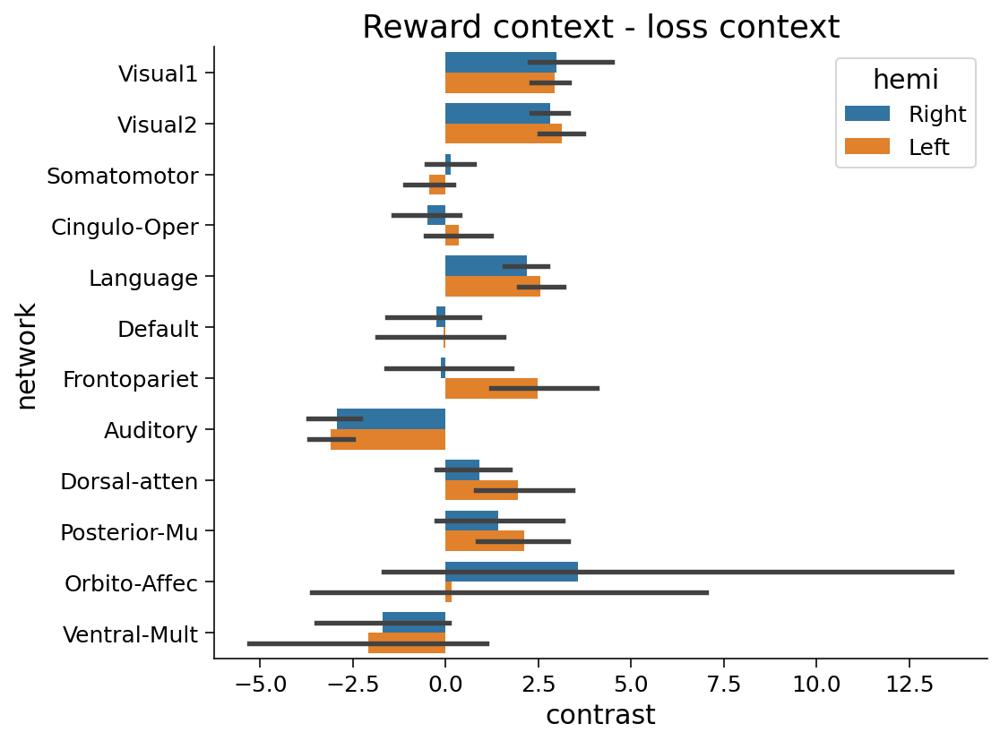

In [14]:
# combine network-level data into dataframe
df = pd.DataFrame({'contrast':group_contrast_blocks_c1,
                   'network':region_info['network'],
                   'hemi':region_info['hemi']})

# create barplot of contrast by hemisphere, for networks
sns.barplot(y='network', x='contrast', data=df, hue='hemi')
plt.title('Reward context - loss context')
plt.show()

Next, we examine the `loss context - reward context` contrast, visualized on the cortial surface and then for the ROIs aggregated into networks:

In [15]:
# generate cortical surface plot
surf_contrast = group_contrast_blocks_c2[atlas["labels_L"]]
plotting.view_surf(fsaverage['infl_left'],
                   surf_contrast,
                   vmax=20)

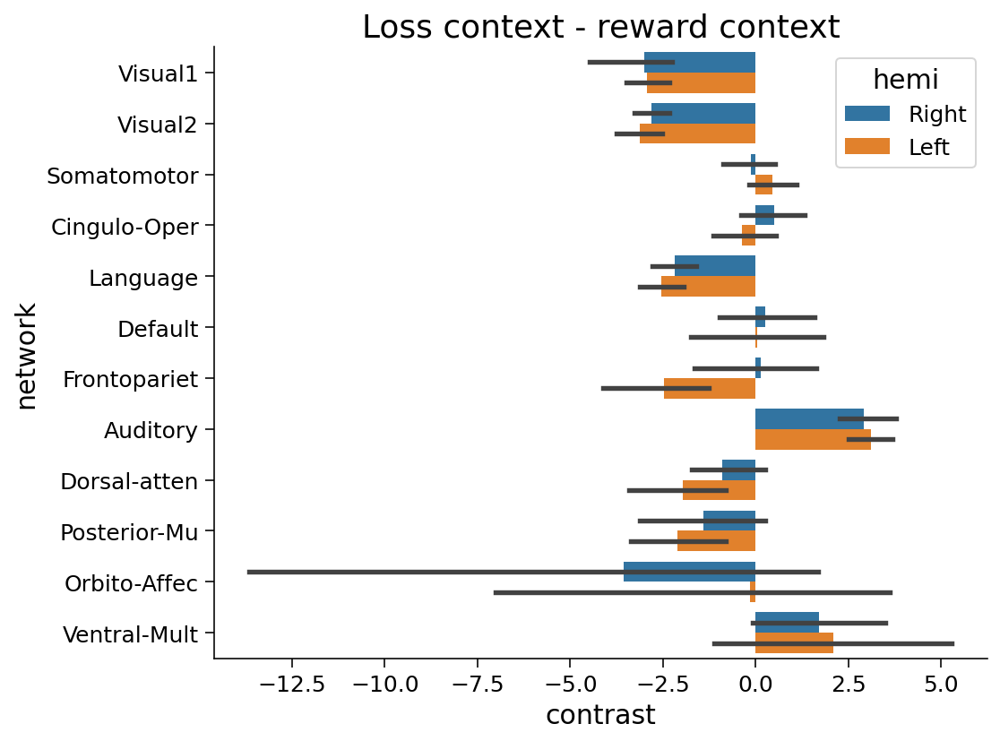

In [16]:
# combine network-level data into dataframe
df = pd.DataFrame({'contrast':group_contrast_blocks_c2,
                   'network':region_info['network'],
                   'hemi':region_info['hemi']})

# create barplot of contrast by hemisphere, for networks
sns.barplot(y='network', x='contrast', data=df, hue='hemi')
plt.title('Loss context - reward context')
plt.show()

## Contrast of reward vs. loss vs. neutral trials

We can now examine various contrasts of reward, loss and neutral trials, independent of block:
- `reward trials - loss trials`
- `reward trials - neutral trials`
- `loss trials - reward trials`
- `loss trials - neutral trials`
- `reward trials - (loss trials + neutral trials)/2`
- `loss trials - (reward trials + neutral trials)/2`

In [17]:
my_exp = 'GAMBLING'
group_contrast_trials_c1 = 0 # contrast of reward vs. loss trial activity
group_contrast_trials_c2 = 0 # contrast of reward vs. neutral trial activity
group_contrast_trials_c3 = 0 # contrast of loss vs. reward trial activity
group_contrast_trials_c4 = 0 # contrast of loss vs. neutral trial activity
group_contrast_trials_c5 = 0 # contrast of reward vs. (loss + neutral) trial activity
group_contrast_trials_c6 = 0 # contrast of loss vs. (reward + neutral) trial activity

for s in subjects:
  for r in [0,1]:
    data = load_single_timeseries(subject=s,experiment=my_exp,run=r,remove_mean=True)
    evs = load_evs(subject=s, experiment=my_exp,run=r)

    win_activity = average_frames(data, evs, my_exp, 'win_event')
    loss_activity = average_frames(data, evs, my_exp, 'loss_event')
    neut_activity = average_frames(data, evs, my_exp, 'neut_event')

    # contrast of reward vs. loss trial activity
    contrast = win_activity - loss_activity
    group_contrast_trials_c1 += contrast

    # contrast of reward vs. neutral trial activity
    contrast = loss_activity - neut_activity
    group_contrast_trials_c2 += contrast

    # contrast of loss vs. reward trial activity
    contrast = loss_activity - win_activity
    group_contrast_trials_c3 += contrast

    # contrast of loss vs. neutral trial activity
    contrast = loss_activity - neut_activity
    group_contrast_trials_c4 += contrast

    # contrast of reward vs. (loss + neutral) trial activity
    contrast = win_activity - (loss_activity + neut_activity)/2
    group_contrast_trials_c5 += contrast

    # contrast of loss vs. (reward + neutral) trial activity
    contrast = loss_activity - (win_activity + neut_activity)/2
    group_contrast_trials_c6 += contrast

group_contrast_trials_c1 /= (len(subjects)*2)  # divide because 2 runs/subject
group_contrast_trials_c2 /= (len(subjects)*2)  # divide because 2 runs/subject
group_contrast_trials_c3 /= (len(subjects)*2)  # divide because 2 runs/subject
group_contrast_trials_c4 /= (len(subjects)*2)  # divide because 2 runs/subject
group_contrast_trials_c5 /= (len(subjects)*2)  # divide because 2 runs/subject
group_contrast_trials_c6 /= (len(subjects)*2)  # divide because 2 runs/subject

First, we examine the `reward - loss` contrast:

In [18]:
# generate cortical surface plot
surf_contrast = group_contrast_trials_c1[atlas["labels_L"]]
plotting.view_surf(fsaverage['infl_left'],
                   surf_contrast,
                   vmax=20)

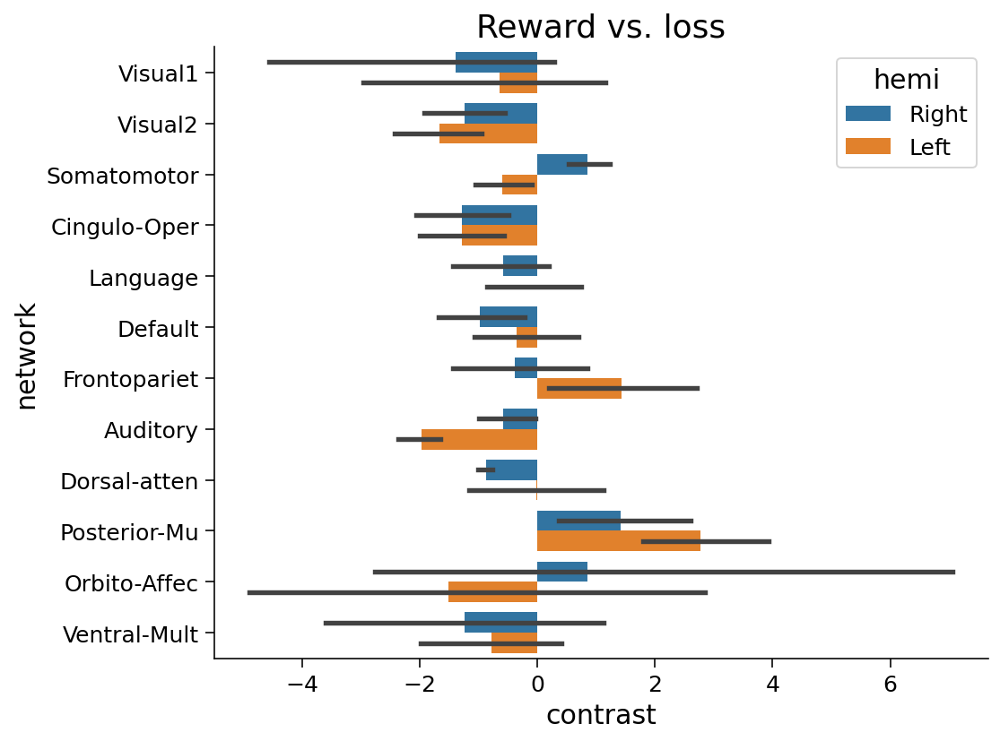

In [19]:
# combine network-level data into dataframe
df = pd.DataFrame({'contrast':group_contrast_trials_c1,
                   'network':region_info['network'],
                   'hemi':region_info['hemi']})

# create barplot of contrast by hemisphere, for networks
sns.barplot(y='network', x='contrast', data=df, hue='hemi')
plt.title('Reward vs. loss')
plt.show()

Next, we examine the `loss - reward` contrast:

---



In [20]:
# generate cortical surface plot
surf_contrast = group_contrast_trials_c3[atlas["labels_L"]]
plotting.view_surf(fsaverage['infl_left'],
                   surf_contrast,
                   vmax=20)

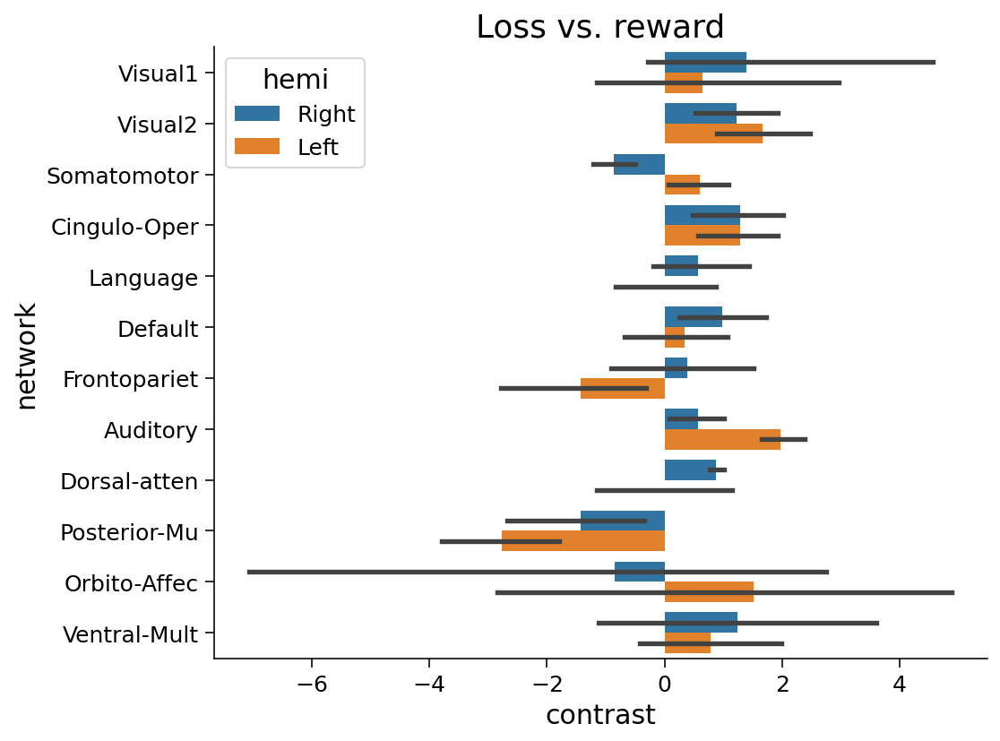

In [21]:
# combine network-level data into dataframe
df = pd.DataFrame({'contrast':group_contrast_trials_c3,
                   'network':region_info['network'],
                   'hemi':region_info['hemi']})

# create barplot of contrast by hemisphere, for networks
sns.barplot(y='network', x='contrast', data=df, hue='hemi')
plt.title('Loss vs. reward')
plt.show()

We can examine the number of ROIs showing contrasts > 1 for each contrast:

In [22]:
n_ROIs_c5 = np.sum(group_contrast_trials_c5 > 0)
print('Reward > (loss + neutral): ' + str(n_ROIs_c5) + ' ROIs')
n_ROIs_c6 = np.sum(group_contrast_trials_c6 > 0)
print('Loss > (reward + neutral): ' + str(n_ROIs_c6) + ' ROIs')

Reward > (loss + neutral): 90 ROIs
Loss > (reward + neutral): 57 ROIs


In [23]:
# show label for each ROI with positive contrast:
#for i, el in enumerate(group_contrast_trials_c5):
  #if el > 0:
    #print('index ' + str(i) + ': ' + region_info['name'][i])

# GLM analysis: Mapping loss- and reward-related activation

In this section, we will set up a general linear model (GLM) where each regressor is a stimulus response model. Then we will regress this model against the fMRI timeseries data, and calculate the resulting betas and associated estimates of uncertainty.

In a second step, we repeat this but convolve the design matrix with the hemodynamic response function (HRF).

## Functions

In [24]:
# a few constants for the gambling task
TR_val = 0.72  # TR (necessary to calculate sampling rate)
run_length = 253  # number of samples for this run (obtained via next 2 lines)
#data = load_single_timeseries(subject=1,experiment=my_exp,run=1,remove_mean=True)
#len(data[0])  # length of timeseries for ROI #1

# number of parcels is the number of rows (360)
n_parcels = 360
#data = load_single_timeseries(subject=s,experiment=my_exp,run=r,remove_mean=True)
#data.shape[0]


# function to load EV file contents to pandas dataframe
def get_ev_dataframe(subject, experiment, run, conditions):
  """load onset files for one subject, experiment and run
  
  Args:
    subject (int): 0-based subject ID to load
    experiment (str) : Name of experiment
    run (int): run number
    conditions (str): List of conditions to include

  Returns
    evs (n_blocks for run x 3 array): Events file for single condition to be formatted for design matrix

  """

  #conditions = EXPERIMENTS[experiment]['cond']
  #conditions = ['win','loss']

  # initialize dataframe to store contents of EV file
  ev_data_all = pd.DataFrame()
  
  task_key = 'tfMRI_'+experiment+'_'+['RL','LR'][run]

  # loop over conditions & extract EV data
  for condition in conditions:
    
    # define EV file
    ev_file  = f"{HCP_DIR}/subjects/{subject}/EVs/{task_key}/{condition}.txt"

    # load EV file contents
    ev_data = pd.read_csv(ev_file, sep="\t", header=None)

    # rename EV data columns to Onset, Duration, Stim (required by NLtools)
    ev_data = ev_data.rename(columns={0: 'Onset', 1: 'Duration'})

    # remove third column
    ev_data = ev_data.drop(columns=[2])

    # add column containing condition info
    ev_data['Stim'] = condition

    # bind data for this condition
    # to composite dataframe for all conditions
    ev_data_all = ev_data_all.append(ev_data)

    # arrange in order of stim onset
    ev_data_all = ev_data_all.sort_values(by="Onset") 

  return ev_data_all


# function to create design matrix
def create_design_matrix(ev_data, experiment, TR):
  """Create design matrix based on a single EV dataframe

  Args:
    ev_data(pandas df): dataframe containing Onset, Duration, Stim columns
    my_exp(str): experiment name
    TR(float): TR value (seconds)

  Return:
    design_mat(np): design matrix containing stimulus response models

  """

  # sampling rate is inverse of TR
  sampling_rate = 1./TR

  # now we use the onsets_to_dm() function from nltools.file_reader()
  # to convert the EV data to a design matrix
  design_mat = onsets_to_dm(ev_data, sampling_freq=sampling_rate, run_length=run_length, )

  # convert from pandas dataframe to np array
  #design_mat.to_numpy()

  return design_mat


# function to solve for betas using OLS
def ordinary_least_squares(X, y):

  # Compute theta_hat using OLS
  theta_hat = np.linalg.inv(X.T @ X) @ X.T @ y.T

  return theta_hat


# function to compute a beta map across all cortical parcels
def compute_beta_map(subject, experiment, run, design_mat, n_parcels):

  # initialize beta-map as a matrix of zeros
  beta_map = np.zeros((n_parcels, design_mat.shape[1]), dtype=float)

  # we loop over parcels, calculating a beta in each case
  for i in np.arange(n_parcels):

    # load timeseries for this parcel
    y = load_single_timeseries(subject=subject, experiment=experiment, run=run)[i]

    # compute betas via OLS
    betas = ordinary_least_squares(design_mat.to_numpy(), y)

    # append betas to list
    beta_map[i,0] = betas[0]
    beta_map[i,1] = betas[1]

  return beta_map


## First-level analysis

First, we create our design matrix $X$, consisting of stimulus response models for each condition of interest. This is illustrated below for a single participant and run. A preview of the dataframe shows 10 rows:

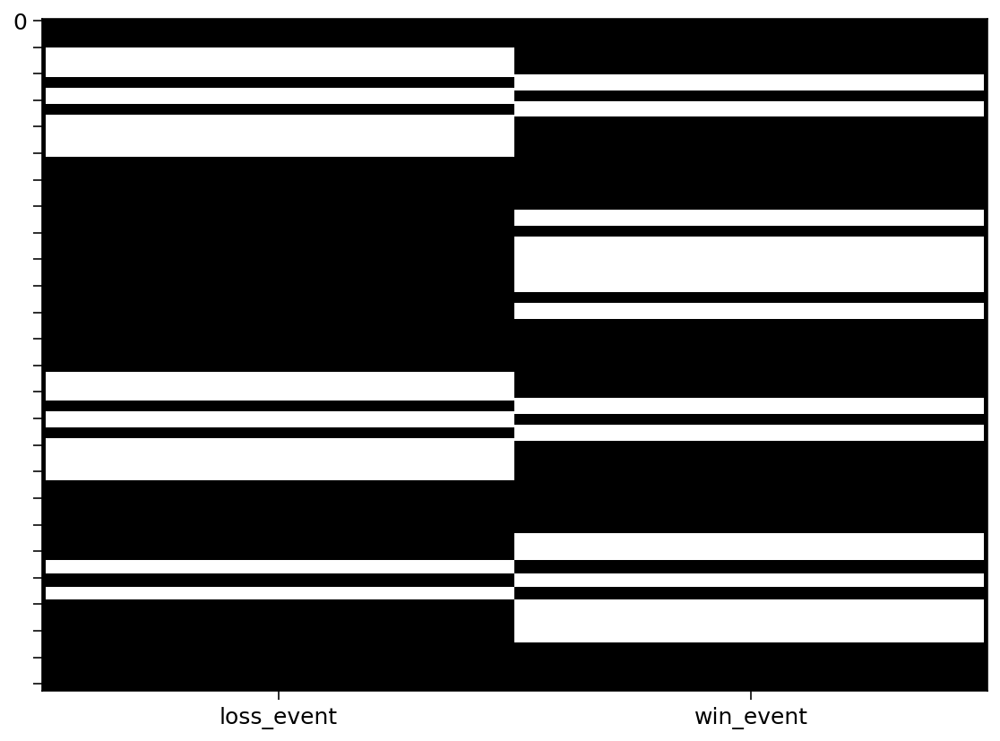

In [25]:
# above we defined a function to convert the info in relevant EV files to a dataframe
# we will start simple by using 1 subject and 1 run
subject=1
experiment='GAMBLING'
run=1
conditions=['win_event','loss_event']

# load EV file contents to dataframe
ev_data = get_ev_dataframe(subject,experiment,run,conditions)

# create design matrix
design_mat = create_design_matrix(ev_data, experiment, TR=TR_val)

# show heatmap of design matrix
design_mat.heatmap()

In [26]:
# show details of design matrix (sampling rate should be 1/TR = 1/0.72 ~ 1.38)
print(design_mat.details())

nltools.data.design_matrix.Design_Matrix(sampling_freq=1.3888888888888888 (hz), shape=(253, 2), multi=False, convolved=[], polynomials=[])


Next, we load our `y`, in this case the fMRI BOLD timeseries from a single parcel. We then calculated our predicted weights ($\hat{\beta}$) using ordinary least squares:

In [27]:
# load our y (single parcel timeseries)
y = load_single_timeseries(subject=subject, experiment=experiment, run=run)[0] # take only first parcel for now

# compute betas via OLS
betas = ordinary_least_squares(design_mat.to_numpy(), y)
print(betas)

[-6.33894665  1.83743389]


We can augment the GLM above with a more realistic response profile, by convolving our design matrix $X$ with a hemodynamic response function (HRF). We will use the HRF implemented in the `nltools` library, developed by Gary Glover:

Text(0.5, 1.0, 'Hemodynamic Response Function')

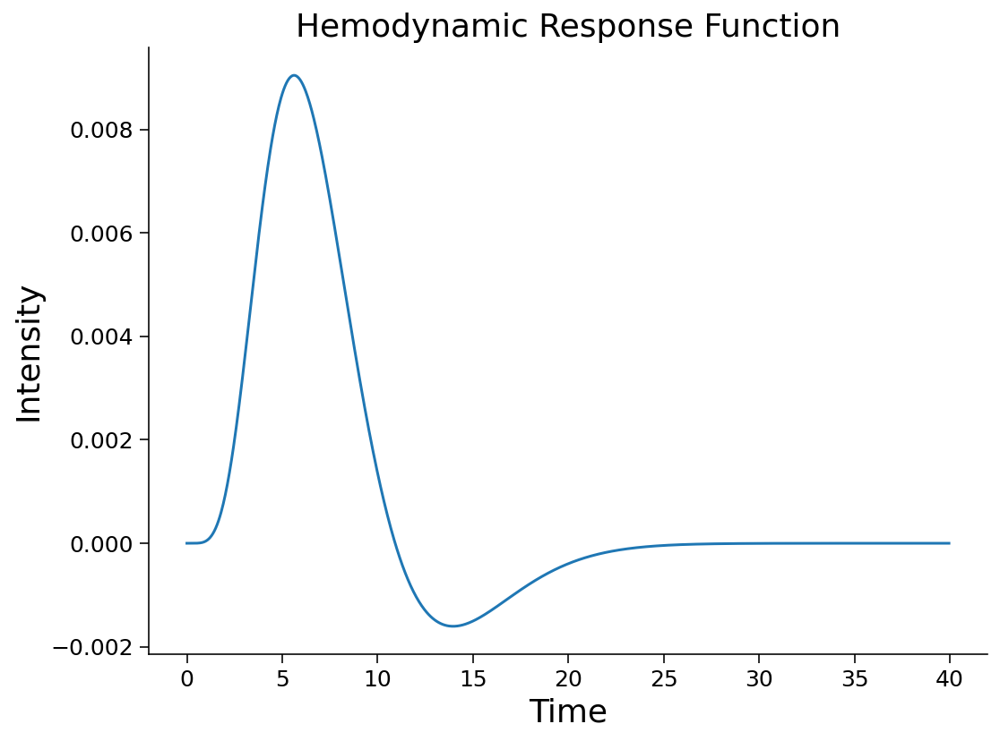

In [28]:
hrf = glover_hrf(TR, oversampling=20, time_length = 40)
time = np.arange(0,(40 / 0.72 * 20))
time = time * (0.72 / 20)
plt.plot(time[:-1], hrf)
plt.ylabel('Intensity', fontsize=18)
plt.xlabel('Time', fontsize=18)
plt.title('Hemodynamic Response Function', fontsize=18)

We convolve this HRF with our stimulus vectors. A visualization of the convolutions for a single participant and run, for win/loss/neutral trial stimulus vectors, is shown below:

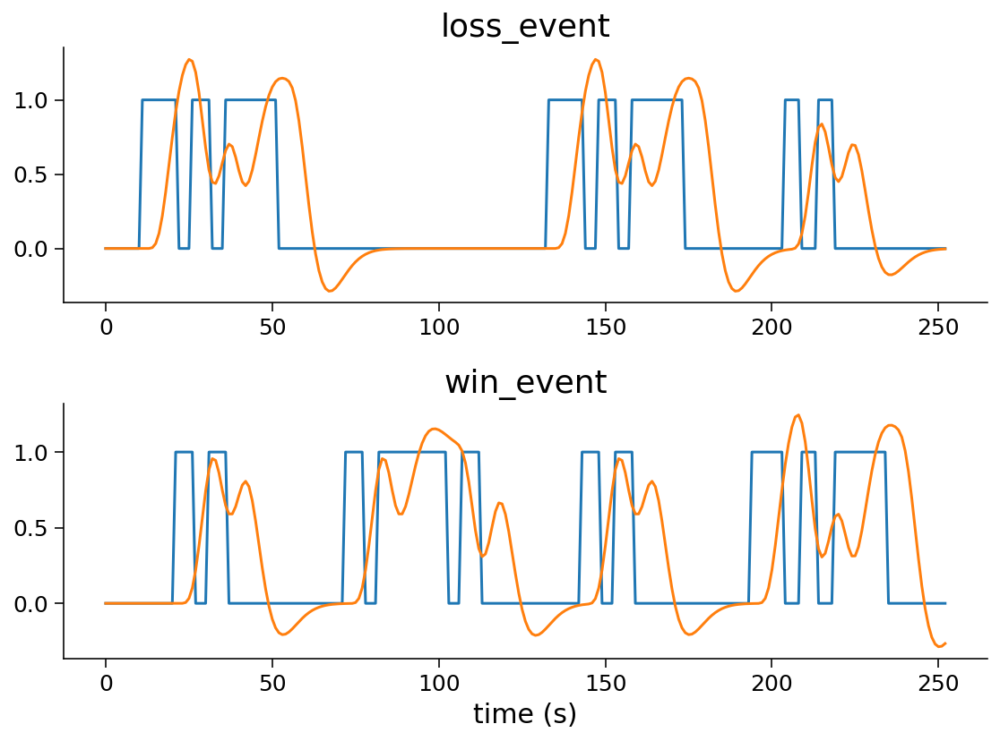

In [29]:
# get list of conditions (columns of design matrix)
conditions = list(design_mat.columns)

# convert design matrix object to array
dm_array = design_mat.to_numpy()

# convolve design matrix with HRF
dm_conv = design_mat.convolve()

# convert convolved dm to array
dm_conv_array = dm_conv.to_numpy()

# initialize figure
plt.figure()

# loop through conditions and plot
for i, condition in enumerate(conditions):
  plt.subplot(len(conditions), 1, i+1).set_title(condition)
  plt.plot(dm_array[:,i])
  plt.plot(dm_conv_array[:,i])

plt.xlabel('time (s)')
plt.tight_layout()

We can use the design matrix, now convolved with the HRF, to again calculate estimated weights:

In [30]:
# compute betas with the design matrix convolved with the HRF
betas = ordinary_least_squares(dm_conv.to_numpy(), y)
betas

array([-0.01372255,  8.79446162])

Next, we repeat the process of estimating the $\hat{\beta}$ values for all parcels. The result is a $\hat{\beta}$ "map" for each condition, with one $\hat{\beta}$ value per parcel.

We repeat this process across runs and participants, averaging within participants. The first plot shows the average beta-map across participants for reward blocks, and the second plot shows that for loss blocks:

In [31]:
# compute beta maps for this participant
#beta_map = compute_beta_map(subject=subject, experiment=experiment, run=run, 
#                            design_mat=dm_conv, n_parcels=n_parcels)
n_runs = 2

# loop over subjects & runs & calculate beta map for each
beta_map = np.empty(shape = (n_parcels,4,len(subjects)))

for s in subjects:

  this_beta_map = np.empty(shape = (n_parcels,4,n_runs))

  for r in [0,1]:
    
    # load EV file contents to dataframe
    ev_data = get_ev_dataframe(subject=s, experiment=experiment, run=r, conditions=conditions)

    # compute design matrix
    dm = create_design_matrix(ev_data=ev_data, experiment=experiment, TR=TR)

    # convolve design matrix with HRF
    dm_conv = design_mat.convolve()

    # compute beta map
    this_beta_map[:,0:2,r] = compute_beta_map(subject=s, experiment=experiment, run=r, design_mat=dm_conv, n_parcels=n_parcels)

    # tba: additional contrasts
    this_beta_map[:,2,r] = this_beta_map[:,1,r] - this_beta_map[:,0,r]  # reward - loss
    this_beta_map[:,3,r] = this_beta_map[:,0,r] - this_beta_map[:,1,r] # loss - reward

  # average over runs for this subject
  beta_map[:,:,s] = np.mean(this_beta_map,axis=2)

# average over all beta maps
beta_map_avg = np.mean(beta_map,axis=2)

In [32]:
# (1) reward only
surf_contrast = beta_map_avg[atlas["labels_L"],1]
plotting.view_surf(fsaverage['infl_left'],
                   surf_contrast,
                   vmax=20)

In [33]:
# (2) loss only
surf_contrast = beta_map_avg[atlas["labels_L"], 0]
plotting.view_surf(fsaverage['infl_left'],
                   surf_contrast,
                   vmax=20)

## Group-level analysis

Next, we should perform a group-level analysis, to examine where reward- and loss-related activation differ from 0, or particular contrasts of conditions, across participants.

For the GLM analyses of reward and loss trials, we will use the calculated beta values for each participant as inputs for a series of t-tests. With these tests, we will test whether the computed betas differ from zero. We can then convert the resulting t-values for each parcel to z-values and reporting z-values above a reasonable threshold (z > 2.3 ~ p < .05) to visualize brain areas activating reliably on reward or loss trials.

In [34]:
n_parcels = 360
n_contrasts = 4

# initialize t-map array
t_map = np.empty(shape = (n_parcels,n_contrasts))

for i in range(n_parcels):

  # compute one-sample t-tests for each contrast
  for j in range(n_contrasts):
    res = stats.ttest_1samp(np.array(beta_map[i,j,:]), popmean=0)
    t_map[i,j] = res.statistic

print(t_map.shape)


(360, 4)


In [35]:
# z-score the t-maps
t_map_z = zscore(t_map, axis=0)

# set z-values < 2.3 to 0
thresh = 2.3
t_map_z_thresh = np.where(t_map_z >= thresh, t_map_z, 0)

# reward - loss
surf_contrast = t_map_z[atlas["labels_L"],2]
plotting.view_surf(fsaverage['infl_left'],
                   surf_contrast,
                   vmax=4)

In [36]:
# in which parcels is t_map_z > thresh?
inds = np.argwhere(t_map_z[:,2] >= thresh)
regions[0][inds]

array([['R_V1'],
       ['R_PBelt'],
       ['R_A5'],
       ['R_A4'],
       ['L_V1'],
       ['L_V2'],
       ['L_PBelt'],
       ['L_A4']], dtype='<U12')

In [37]:
# loss - reward
surf_contrast = t_map_z[atlas["labels_L"],3]
plotting.view_surf(fsaverage['infl_left'],
                   surf_contrast,
                   vmax=4)

In [38]:
# in which parcels is t_map_z > thresh?
inds = np.argwhere(t_map_z[:,3] >= thresh)
regions[0][inds]

array([['R_SCEF'],
       ['R_6ma'],
       ['R_FOP4'],
       ['L_SCEF'],
       ['L_6ma'],
       ['L_p32pr']], dtype='<U12')

Next, we want to examine brain regions where the contrast of reward and loss trials, and vice versa, was significant. To do so, we apply a contrast vector...

# Logistic regression analysis: Predicting trial type from activity

Next, use logistic regression to attempt to predict trial type (reward, loss) based on brain activity.

## With whole-brain data

We will start by using data from the whole brain (all parcels). To do this, we will need to average the fMRI timeseries for each parcel and trial. The function below accomplishes this. Other functions in this cell do some steps we will need for logistic regression:

In [39]:
# function to average fMRI timeseries
# over events within a condition
# and get event labels
# for a given participant, experiment and run

def get_event_data(data, evs, conditions, codes):

  # determine number of trials (reward + loss)
  n_trials = 0
  for i,cond in enumerate(conditions):
    n_trials += len(evs[EXPERIMENTS[experiment]['cond'].index(cond)])
  
  # loop over specified conditions
  cond_means = np.empty((1,360))
  cond_labels = []
  #print(cond_labels)
  for i,cond in enumerate(conditions):

    # get index of this condition
    idx = EXPERIMENTS[experiment]['cond'].index(cond)

    # loop over events in condition
    # and take average of signal for each parcel for each event
    # and get trial information
    this_cond_means = np.zeros((len(evs[idx]), n_parcels))
    this_cond_labels = np.zeros((len(evs[idx])))
    for j in range(len(evs[idx])):
        this_cond_means[j,:] = np.mean(data[:,evs[idx][j]],axis=1,keepdims=True).T
        this_cond_labels[j] = codes[i] # store condition label

    # append labels to composite array
    cond_labels = np.append(cond_labels, this_cond_labels)

    # append means to composite array
    if i == 0:
      cond_means = this_cond_means
    else:
      cond_means = np.vstack((cond_means, this_cond_means))
    
  return cond_means, cond_labels


# function to split data into training and test sets
def split_data(X, y):

  # TBA

  return X_train, X_test, y_train, y_test


# function to compute MSE
def compute_MSE(y, y_pred):
  
  MSE = np.mean(y_pred != y)

  return MSE

# function to compute accuracy of logreg predictions
def compute_accuracy(X, y, model):
  """Compute accuracy of classifier predictions.

  Args:
    X (2D array): Data matrix
    y (1D array): Label vector
    model (sklearn estimator): Classifier with trained weights.

  Returns:
    accuracy (float): Proportion of correct predictions.
  """

  y_pred = model.predict(X)

  accuracy = 1 - compute_MSE(y, y_pred)

  return accuracy

In [40]:
# test that the data setup is working
data = load_single_timeseries(subject=subject, experiment=experiment, run=run, remove_mean=True)
evs = load_evs(subject=subject, experiment=experiment, run=run)
conditions = ['win_event','loss_event']
codes = [1,0]

# extract data for both runs for a single participant
# (this participant has 58 trials)
y = []
for r in [0,1]:
  data = load_single_timeseries(subject=s, experiment=experiment, run=r, remove_mean=True)
  evs = load_evs(subject=subject, experiment=experiment, run=r)
  this_X, this_y = get_event_data(data=data, evs=evs, conditions=conditions, codes=codes)
  y = np.append(y, this_y)
  if r == 0:
    X = this_X
  else:
    X = np.vstack((X, this_X))

print(X.shape, y.shape)

(58, 360) (58,)


We now aggregate over participants, creating the data from all trials from all runs and participants. Critically, we split the data into training, validation adn test sets at this step:

In [41]:
# split data into test, training and validation sets
subjects_train, subjects_val = sklearn.model_selection.train_test_split(subjects, test_size=0.2, random_state=1)
subjects_val, subjects_test = sklearn.model_selection.train_test_split(subjects_val, test_size=0.25, random_state=1)
print('size of training, validation and test sets are: ' + str(len(subjects_train)) + ', ' + str(len(subjects_val)) + ', ' + str(len(subjects_test)))

size of training, validation and test sets are: 271, 51, 17


In [42]:
for s in subjects_train:
  if s == subjects_train[0]:
    print(s)

311


In [43]:
# function to compile logistic regression data for a subset of subjects
def get_lr_data(subset):

  for s in subset:
    for r in [0,1]:
      data = load_single_timeseries(subject=s, experiment=experiment, run=r, remove_mean=True)
      evs = load_evs(subject=s, experiment=experiment, run=r)
      this_X, this_y = get_event_data(data=data, evs=evs, conditions=conditions, codes=codes)
      if s == subset[0]:
        if r == 0:
          X = this_X
          y = this_y
        else:
          X = np.vstack((X, this_X))
          y = np.append(y, this_y)
      else:
        X = np.vstack((X, this_X))
        y = np.append(y, this_y)

  return X, y


# subset training data
X_train, y_train = get_lr_data(subset=subjects_train)
print(X_train.shape, y_train.shape)

# subset validation data
X_val, y_val = get_lr_data(subset=subjects_val)
print(X_val.shape, y_val.shape)

# subset test data
X_test, y_test = get_lr_data(subset=subjects_test)
print(X_test.shape, y_test.shape)

(15717, 360) (15717,)
(2958, 360) (2958,)
(986, 360) (986,)


In [44]:
#y = []
#for s in subjects:
#  for r in [0,1]:
#    data = load_single_timeseries(subject=s, experiment=experiment, run=r, remove_mean=True)
#    evs = load_evs(subject=s, experiment=experiment, run=r)
#    this_X, this_y = get_event_data(data=data, evs=evs, conditions=conditions, codes=codes)
#    if s == 0 & r == 0:
#      X = this_X
#      y = this_y
#    else:
#      X = np.vstack((X, this_X))
#      y = np.append(y, this_y)

#print(X.shape, y.shape)

We initialize and fit the logistic regression model, testing its accuracy on the validation set:

In [45]:
# initialize logistic regression model
log_reg = LogisticRegression(penalty="none", max_iter=5000)

# fit the model
log_reg.fit(X_train, y_train)

# compute model accuracy on training data
train_accuracy = compute_accuracy(X_train, y_train, log_reg)
print(f"Accuracy on the training data: {train_accuracy:.2%}")

# compute model accuracy on validation data
test_accuracy = compute_accuracy(X_val, y_val, log_reg)
print(f"Accuracy on the test data: {test_accuracy:.2%}")

# compute cross-validated accuracy
#accuracies = cross_val_score(LogisticRegression(penalty='none'), X, y, cv=8)
#cv_accuracy = np.mean(accuracies)
#print(f"Mean 8-fold cross-validated accuracy: {cv_accuracy:.2%}")

Accuracy on the training data: 63.27%
Accuracy on the test data: 59.50%


In [46]:
# tba: add visualization of betas (informative parcels)
# tba: use beta maps for classification (take into hrf)

## With L2 regularization

The model does pretty well at predicting trial type! But we have a lot of predictors (360) and a relatively small number of samples (16). So we should try regularization (below):

In [47]:
# initialize logistic regression model with L2 regularization
log_reg_l2 = LogisticRegression(penalty="l2", C=1, max_iter=5000)

# fit the model
log_reg_l2.fit(X_train, y_train)

# compute model accuracy on training data (should be 100%)
train_accuracy_l2 = compute_accuracy(X_train, y_train, log_reg_l2)
print(f"Accuracy on the training data: {train_accuracy_l2:.2%}")

# compute model accuracy on test data
test_accuracy_l2 = compute_accuracy(X_test, y_test, log_reg)
print(f"Accuracy on the test data: {test_accuracy_l2:.2%}")

# compute cross-validated accuracy for L2 model
#accuracies = cross_val_score(LogisticRegression(penalty='l2', C = 1), X, y, cv=8)
#cv_accuracy_l2 = np.mean(accuracies)
#print(f"Mean 8-fold cross-validated accuracy: {cv_accuracy_l2:.2%}")

# tba: use cv to select hyperparameter

Accuracy on the training data: 63.28%
Accuracy on the test data: 58.01%


## With dimensionality reduction

As another solution to our problem of having many predictors, we can try reducing the dimensionality of the input data, prior to fitting the logistic regression model. The following function implements principal component analysis (PCA) to reduce the dimensionality of our $X$:

In [48]:
# function to perform PCA
def pca(X):
  """
  Sorts eigenvalues and eigenvectors in decreasing order.

  Args:
    X (numpy array of floats): Data matrix each column corresponds to a
                               different random variable

  Returns:
    (numpy array of floats)  : Data projected onto the new basis
    (numpy array of floats)  : Vector of eigenvalues
    (numpy array of floats)  : Corresponding matrix of eigenvectors

  """

  # Calculate the sample covariance matrix
  X = X - np.mean(X)
  cov_matrix = (X.T @ X) / len(X)

  # Calculate the eigenvalues and eigenvectors
  evals, evectors = np.linalg.eigh(cov_matrix)

  # Sort the eigenvalues in descending order
  evals, evectors = sort_evals_descending(evals, evectors)

  # Project the data onto the new eigenvector basis
  score = X @ evectors

  return score, evectors, evals


# function to sort eigenvalues and eigenvectors in decreasing order
def sort_evals_descending(evals, evectors):
  """
  Sorts eigenvalues and eigenvectors in decreasing order. Also aligns first two
  eigenvectors to be in first two quadrants (if 2D).

  Args:
    evals (numpy array of floats)    : Vector of eigenvalues
    evectors (numpy array of floats) : Corresponding matrix of eigenvectors
                                        each column corresponds to a different
                                        eigenvalue

  Returns:
    (numpy array of floats)          : Vector of eigenvalues after sorting
    (numpy array of floats)          : Matrix of eigenvectors after sorting
  """

  index = np.flip(np.argsort(evals))
  evals = evals[index]
  evectors = evectors[:, index]
  if evals.shape[0] == 2:
    if np.arccos(np.matmul(evectors[:, 0],
                           1 / np.sqrt(2) * np.array([1, 1]))) > np.pi / 2:
      evectors[:, 0] = -evectors[:, 0]
    if np.arccos(np.matmul(evectors[:, 1],
                           1 / np.sqrt(2) * np.array([-1, 1]))) > np.pi / 2:
      evectors[:, 1] = -evectors[:, 1]
  return evals, evectors


# function to calculate % variance explained
def get_variance_explained(evals):
  """
  Calculates variance explained from the eigenvalues.

  Args:
    evals (numpy array of floats) : Vector of eigenvalues

  Returns:
    (numpy array of floats)       : Vector of variance explained

  """

  # Cumulatively sum the eigenvalues
  csum = np.cumsum(evals)

  # Normalize by the sum of eigenvalues
  variance_explained = csum / np.sum(evals)

  return variance_explained


(0.0, 100.0)

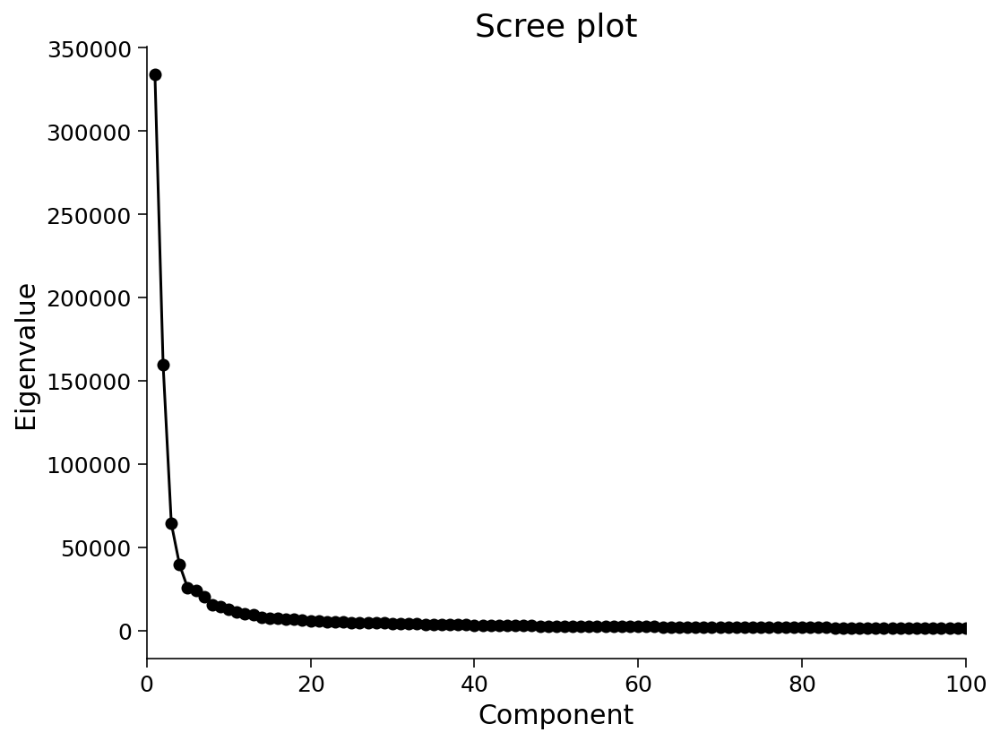

In [49]:
# apply PCA to our data
X_scores, evectors, evals = pca(X_train)

# plot eigenvalues
#len(evectors)
plt.figure(figsize=(8, 6))
plt.plot(np.arange(1, len(evals) + 1), evals, 'o-k')
plt.xlabel('Component')
plt.ylabel('Eigenvalue')
plt.title('Scree plot')
plt.xlim([0, 100]) # only show first 100 components for brevity

Text(0.5, 1.0, 'Percent variance explained')

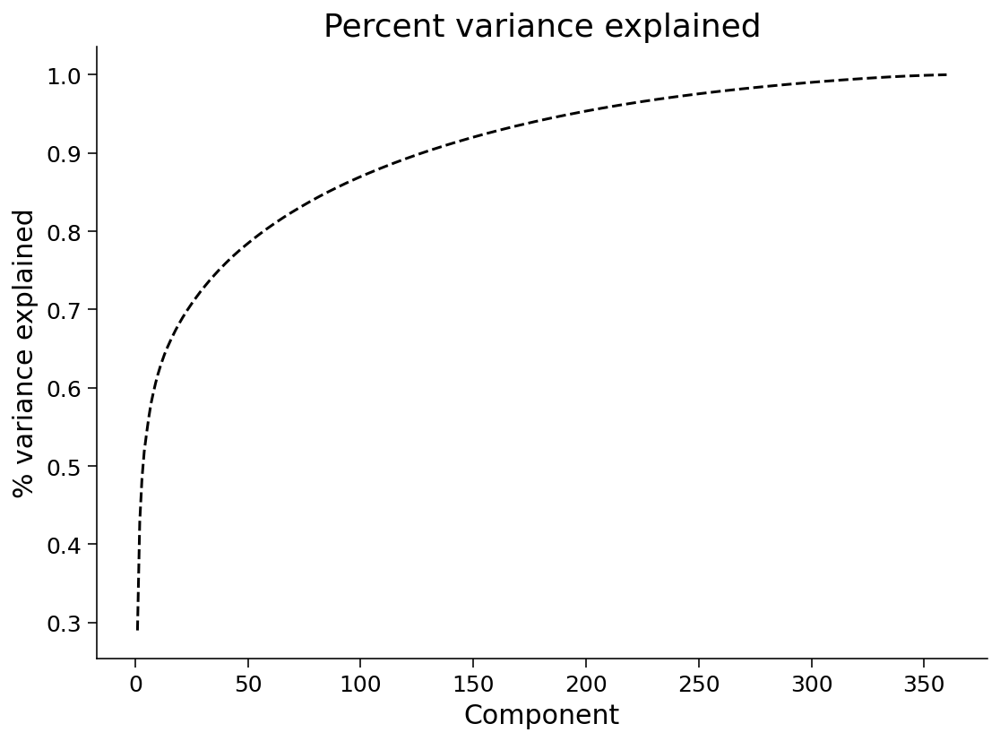

In [50]:
var_explained = get_variance_explained(evals)
plt.figure(figsize=(8, 6))
plt.plot(np.arange(1, len(var_explained) + 1), var_explained, '--k')
plt.xlabel('Component')
plt.ylabel('% variance explained')
plt.title('Percent variance explained')

It looks like a small number of components explain a large proportion of the variance in the data. Thus, we select the first $n$ components that explain 90% of the data:

In [51]:
def select_n_components(evals, threshold):

  """
  Selects number of components that explain a given percent of the variance
  
  Args:
    evals: eigenvalues, sorted from highest to lowest
    threshold: % variance explained, will return number of components that explain up to this % of the variance

  Return:
    n_components: number of components

  """  

  # calculate cumulative % variance explained for each component
  var_explained = get_variance_explained(evals)

  # find all components that explain up to specified % variance
  comps = np.nonzero(var_explained <= threshold)[0]

  # return the last number of components + the next one
  n_comps = comps[-1] + 1

  return n_comps


In [52]:
threshold_var = 0.90
n_comps = select_n_components(evals=evals, threshold=threshold_var)
print('90% of the variance explained by: ' + str(n_comps) + ' components')

90% of the variance explained by: 127 components


We now reconstruct the data ($X$) using only a subset of components, taking only the number of components calculated above:


In [53]:
def reconstruct_data(score, evectors, X_mean, K):
  """
  Reconstruct the data based on the top K components.

  Args:
    score (numpy array of floats)    : Score matrix
    evectors (numpy array of floats) : Matrix of eigenvectors
    X_mean (numpy array of floats)   : Vector corresponding to data mean
    K (scalar)                       : Number of components to include

  Returns:
    (numpy array of floats)          : Matrix of reconstructed data

  """

  # Reconstruct the data from the score and eigenvectors
  # Don't forget to add the mean!!
  X_reconstructed = (score[:, :K] @ evectors[:, :K].T) + X_mean

  return X_reconstructed

In [54]:
# reconstruct the data with subset of components
X_mean = np.mean(X_train, 0)
X_reduced = reconstruct_data(score=X_scores, evectors=evectors, X_mean=X_mean, K=n_comps)
X_reduced.shape

(15717, 360)

And now we repeat the logistic regression, using this reduced data as our $X$:

In [55]:
# fit the model
log_reg = LogisticRegression(penalty="none")
log_reg.fit(X_reduced, y_train)

# compute model accuracy on training data
train_accuracy_dr = compute_accuracy(X=X_reduced, y=y_train, model=log_reg)
print(f"Accuracy on the training data: {train_accuracy_dr:.2%}")

# compute model accuracy on test data
test_accuracy_dr = compute_accuracy(X=X_test, y=y_test, model=log_reg)
print(f"Accuracy on the test data: {test_accuracy_dr:.2%}")

# compute cross-validated accuracy for DR model
#accuracies = cross_val_score(LogisticRegression(penalty='none'), X_reduced, y, cv=8)
#cv_accuracy_l2 = np.mean(accuracies)
#print(f"Mean 8-fold cross-validated accuracy: {cv_accuracy_l2:.2%}")

Accuracy on the training data: 60.32%
Accuracy on the test data: 52.13%


# GLM Analysis: Testing the effect of reward context




Now we fit a GLM to examine the potential impact of reward context on reward- and loss-related brain activity. The design matrix for this GLM consists of various trial types organized by reward context. An example of this design matrix for a single subject and run is shown below:

/usr/local/lib/python3.7/dist-packages/nltools/file_reader.py:141: UserWarning: Computed onsets for loss_event are inconsistent with expected values. Please manually verify the outputted Design_Matrix!
  f"Computed onsets for {data.Stim.unique()[i]} are inconsistent with expected values. Please manually verify the outputted Design_Matrix!"
/usr/local/lib/python3.7/dist-packages/nltools/file_reader.py:141: UserWarning: Computed onsets for loss are inconsistent with expected values. Please manually verify the outputted Design_Matrix!
  f"Computed onsets for {data.Stim.unique()[i]} are inconsistent with expected values. Please manually verify the outputted Design_Matrix!"
/usr/local/lib/python3.7/dist-packages/nltools/file_reader.py:141: UserWarning: Computed onsets for win_event are inconsistent with expected values. Please manually verify the outputted Design_Matrix!
  f"Computed onsets for {data.Stim.unique()[i]} are inconsistent with expected values. Please manually verify the outputt

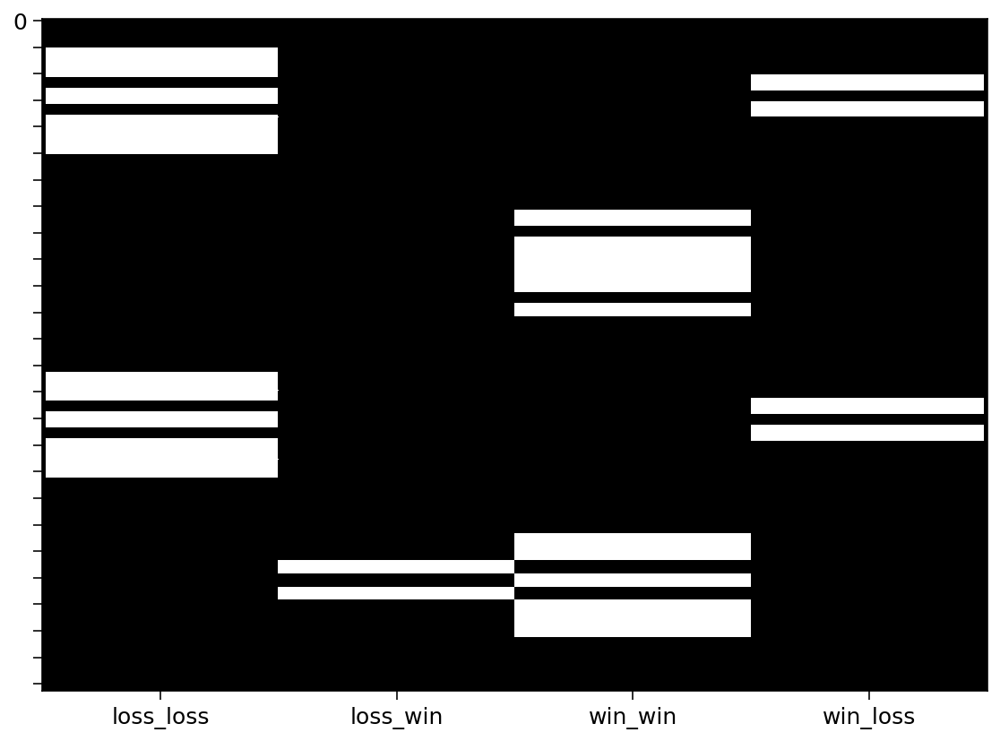

In [56]:
# create ev data for GLM
ev_data = get_ev_dataframe(subject=subject, experiment=experiment, run=1, conditions = ['win_event', 'loss_event', 'win', 'loss'])

# create design matrix for GLM
design_mat = create_design_matrix(ev_data=ev_data, experiment=experiment, TR=TR)

# add columns reflecting bins of interest
design_mat['loss_loss'] = np.where(design_mat.eval('loss_event == 1.0 and loss == 1.0'), 1.0, 0.0)
design_mat['loss_win'] = np.where(design_mat.eval('loss_event == 1.0 and win == 1.0'), 1.0, 0.0)
design_mat['win_win'] = np.where(design_mat.eval('win_event == 1.0 and win == 1.0'), 1.0, 0.0)
design_mat['win_loss'] = np.where(design_mat.eval('win_event == 1.0 and loss == 1.0'), 1.0, 0.0)
design_mat = design_mat.drop(['loss_event', 'loss', 'win_event', 'win'], axis=1)
design_mat.heatmap()

And below, the design matrix convolved with the HRF:

Text(0.5, 0, 'time (s)')

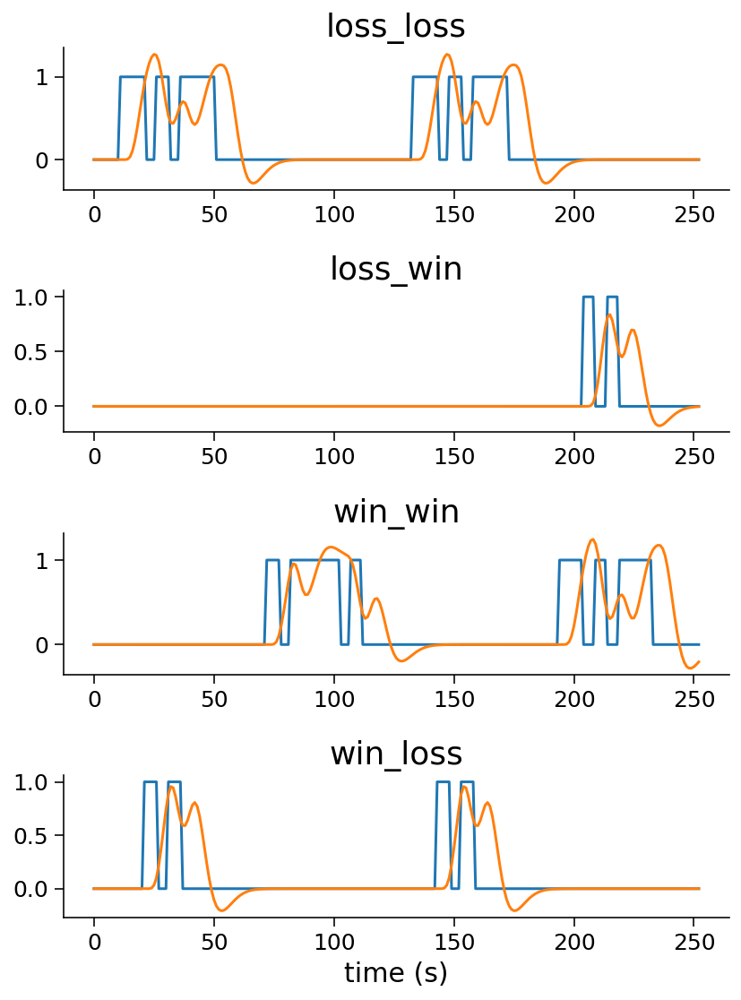

In [57]:
# convert design matrix object to array
dm_array = design_mat.to_numpy()

# convolve design matrix with HRF
dm_conv = design_mat.convolve()

# convert convolved dm to array
dm_conv_array = dm_conv.to_numpy()

# initialize figure
plt.figure(figsize=(6,8))

# loop through conditions and plot
for i, condition in enumerate(design_mat.columns):
  plt.subplot(len(design_mat.columns), 1, i+1).set_title(condition)
  plt.plot(dm_array[:,i])
  plt.plot(dm_conv_array[:,i])

plt.xlabel('time (s)')

Below we define a function to compute the beta map across all cortical parcels, for each stimulus response model above:

In [58]:
# function to compute a beta map across all cortical parcels for context GLM
def compute_beta_map_contextGLM(subject, experiment, run, design_mat, n_parcels):

  # initialize beta-map as a matrix of zeros
  beta_map = np.zeros((n_parcels, design_mat.shape[1]), dtype=float)

  # we loop over parcels, calculating betas in each case
  for i in np.arange(n_parcels):

    # load timeseries for this parcel
    y = load_single_timeseries(subject=subject, experiment=experiment, run=run)[i]

    # compute betas via OLS
    betas = ordinary_least_squares(design_mat.to_numpy(), y)

    beta_map[i,:] = betas

  return beta_map


We run this function to create beta maps for each participant, averaging over their two runs. We average across all participants to generate one beta map for each stimulus response vector:

In [59]:
n_parcels = 360
n_stims = 4
n_runs = 2

# loop over subjects & runs & calculate beta map for each
beta_map = np.empty(shape = (n_parcels,n_stims,len(subjects)))

for s in subjects:

  this_beta_map = np.empty(shape = (n_parcels,n_stims,n_runs))

  for r in [0,1]:
    
    # load EV file contents to dataframe
    ev_data = get_ev_dataframe(subject=subject, experiment=experiment, run=r, conditions = ['win_event', 'loss_event', 'win', 'loss'])

    # create design matrix for GLM
    dm = create_design_matrix(ev_data=ev_data, experiment=experiment, TR=TR)

    # add columns reflecting bins of interest
    dm['loss_loss'] = np.where(dm.eval('loss_event == 1.0 and loss == 1.0'), 1.0, 0.0)
    dm['loss_win'] = np.where(dm.eval('loss_event == 1.0 and win == 1.0'), 1.0, 0.0)
    dm['win_win'] = np.where(dm.eval('win_event == 1.0 and win == 1.0'), 1.0, 0.0)
    dm['win_loss'] = np.where(dm.eval('win_event == 1.0 and loss == 1.0'), 1.0, 0.0)
    dm = dm.drop(['loss_event', 'loss', 'win_event', 'win'], axis=1)

    # convolve design matrix with HRF
    dm_conv = dm.convolve()

    # compute beta map
    this_beta_map[:,:,r] = compute_beta_map_contextGLM(subject=s, experiment=experiment, run=r, design_mat=dm_conv, n_parcels=n_parcels)

  # average over runs for this subject
  beta_map[:,:,s] = np.mean(this_beta_map,axis=2)

# average over all beta maps
beta_map_avg = np.mean(beta_map,axis=2)
print(beta_map_avg.shape)

/usr/local/lib/python3.7/dist-packages/nltools/file_reader.py:141: UserWarning: Computed onsets for win_event are inconsistent with expected values. Please manually verify the outputted Design_Matrix!
  f"Computed onsets for {data.Stim.unique()[i]} are inconsistent with expected values. Please manually verify the outputted Design_Matrix!"
/usr/local/lib/python3.7/dist-packages/nltools/file_reader.py:141: UserWarning: Computed onsets for win are inconsistent with expected values. Please manually verify the outputted Design_Matrix!
  f"Computed onsets for {data.Stim.unique()[i]} are inconsistent with expected values. Please manually verify the outputted Design_Matrix!"
/usr/local/lib/python3.7/dist-packages/nltools/file_reader.py:141: UserWarning: Computed onsets for loss_event are inconsistent with expected values. Please manually verify the outputted Design_Matrix!
  f"Computed onsets for {data.Stim.unique()[i]} are inconsistent with expected values. Please manually verify the outputte

(360, 4)


## RDMs

Next, using the generated beta maps, we can compare the beta maps for the conditions of interest in matrix form: reward trials in reward blocks, reward trials in loss blocks, and so on. The resulting representational dissimilarity matrix (RDM) is expected to inform our question of how reward context affects brain activity during the task. 

In [60]:
def plot_corr_matrix(rdm, labs, ax=None):
  """Plot dissimilarity matrix

  Args:
    rdm (numpy array): n_stimuli x n_stimuli representational dissimilarity
      matrix
    ax (matplotlib axes): axes onto which to plot

  Returns:
    nothing

  """
  if ax is None:
    ax = plt.gca()
    image = ax.imshow(rdm, vmin=0.0, vmax=0.50)
    #ax.set_xticks([])
    #ax.set_yticks([])
    ax.set_xticklabels(labs)
    ax.set_yticklabels(labs)
    
    cbar = plt.colorbar(image, ax=ax, label='dissimilarity')

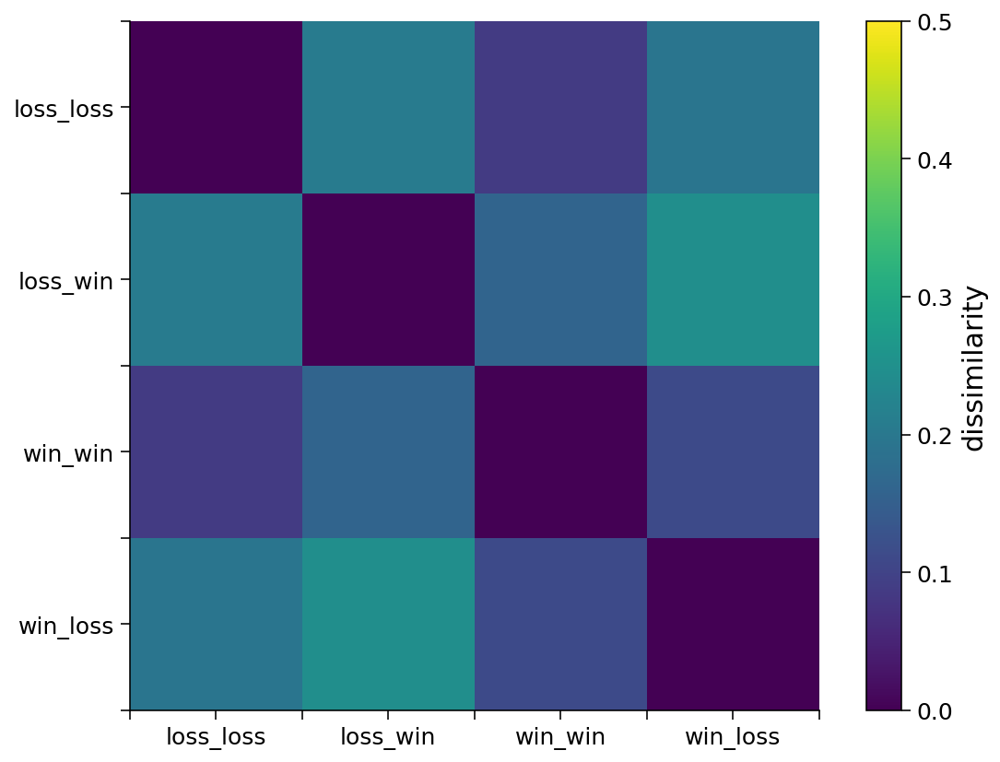

In [61]:
# create RDM based on trial GLM average-beta-map ("trial version")
zbeta = zscore(beta_map_avg, axis=0)
rdm = 1 - ((1/zbeta.shape[0]) * zbeta.T @ zbeta)

# plot rdm
plot_corr_matrix(rdm, labs=['', 'loss_loss', '', 'loss_win', '', 'win_win', '', 'win_loss', ''])

We can visualize relevant cells that we wish to compare, using a barplot:

In [62]:
# function to convert rgb tuple to hex code
def rgb_to_hex(rgb):
    return '%02x%02x%02x' % rgb

# function to return color palette matching RDM
def get_palette(dissimilarity_values, vmax):
  norm = colors.Normalize(vmin=0, vmax=vmax)
  mycmap = plt.cm.viridis

  mycolor = mycmap(norm(dissimilarity_values))
  mycolor = mycolor*255
  mycolor = mycolor[:,0:3]
  mycolor = np.ceil(mycolor)
  
  color_hex = np.empty(len(mycolor), dtype='object')
  for i, color in enumerate(mycolor.astype('int')):
    color_tup = tuple(color)
    color_hex[i] = '#' + rgb_to_hex(color_tup)
  
  return color_hex


Below, we want to know whether loss trials in win blocks were more similar to: (a) loss trials in loss blocks, or (b) win trials in win blocks?

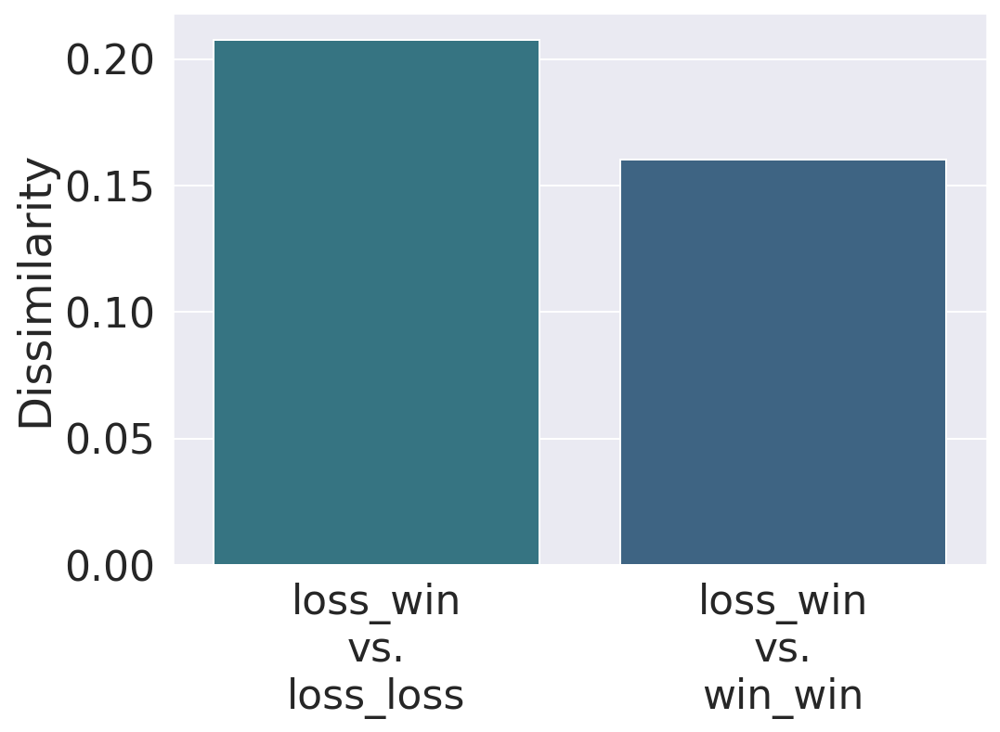

In [63]:
# create barplot showing loss_win vs. loss_loss & loss_win vs. win_win
vals = [rdm[0,1], rdm[1,2]]

# combine network-level data into dataframe
df = pd.DataFrame({'Dissimilarity':vals,
                   'X':['loss_win\nvs.\nloss_loss', 'loss_win\nvs.\nwin_win'],
                   'label':['first','second']})

# create barplot of contrast by hemisphere, for networks
sns.set(font_scale = 2)
sns.barplot(x='X', y='Dissimilarity', data=df,
            hue='label', dodge=False,
            palette=get_palette(vals, vmax=0.5))
plt.xlabel('')
plt.legend([],[], frameon=False)
plt.show()

Next, we want to know whether win trials in loss blocks were more similar to (a) win trials in win blocks, or (b) loss trials in loss blocks?

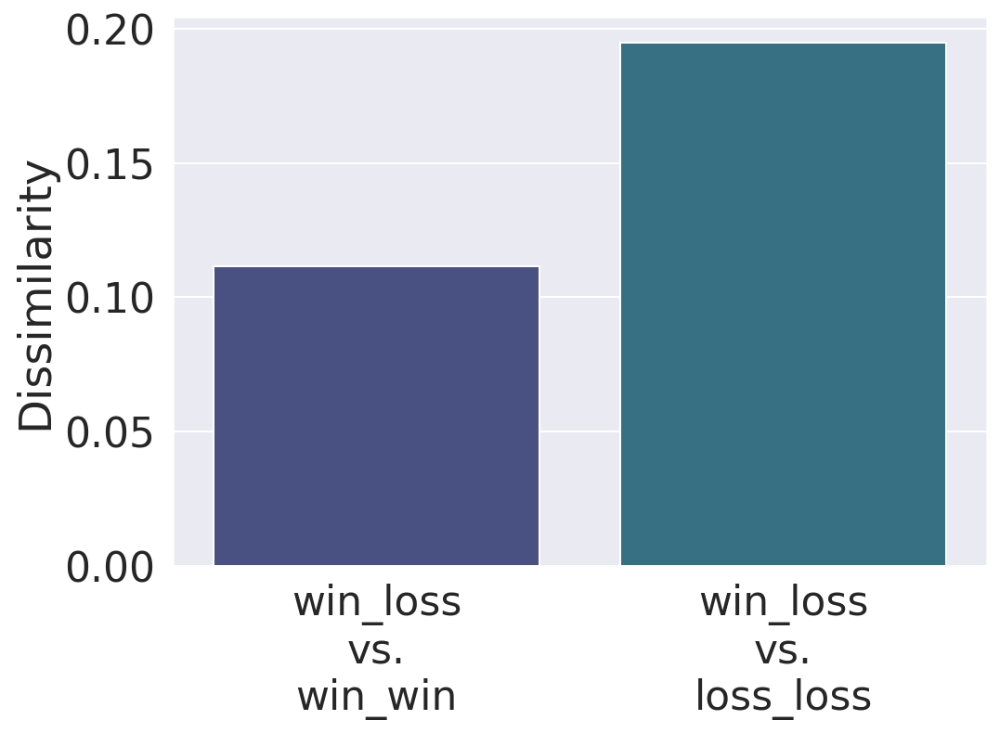

In [64]:
# create barplot showing loss_win vs. loss_loss & loss_win vs. win_win
vals = [rdm[3,2], rdm[3,0]]

# combine network-level data into dataframe
df = pd.DataFrame({'Dissimilarity':vals,
                   'X':['win_loss\nvs.\nwin_win', 'win_loss\nvs.\nloss_loss'],
                   'label':['first','second']})

# create barplot of contrast by hemisphere, for networks
sns.set(font_scale = 2)
sns.barplot(x='X', y='Dissimilarity', data=df,
            hue='label', dodge=False,
            palette=get_palette(vals, vmax=0.5))
plt.xlabel('')
plt.legend([],[], frameon=False)
plt.show()

We can also rearrange the RDM to group similar contexts together; notice that the top-left 2x2 matrix shows the loss context, and the bottom-right 2x2 matrix shows the win context.

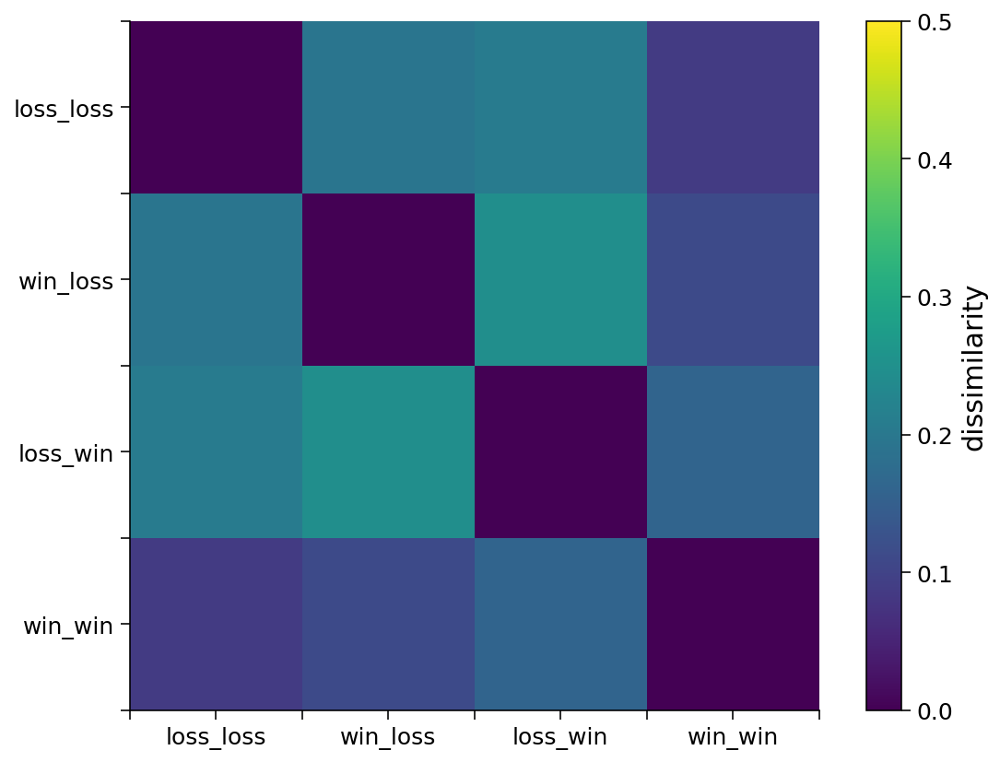

In [ ]:
# plot RDM in different layout, reflecting "context version"
beta_map_avg_rearr = beta_map_avg[:,[0,3,1,2]]
zbeta = zscore(beta_map_avg_rearr, axis=0)
rdm_rearr = 1 - ((1/zbeta.shape[0]) * zbeta.T @ zbeta)

# plot rdm
plot_corr_matrix(rdm_rearr, labs=['', 'loss_loss', '', 'win_loss', '', 'loss_win', '', 'win_win', ''])

## Beta maps

Now we can use the $\hat{\beta}$ values from this analysis to examine brain regions that showed more reliable activation:
- On reward trials in loss blocks than reward trials in reward blocks
- On loss trials in reward blocks than loss trials in loss blocks
- On incongruent vs. congruent trials

First, we loop over subjects and compute relevant contrasts of the $\hat{\beta}$ values for each participant:

In [ ]:
# loop over subjects & runs & calculate beta map for each
beta_map_withc = np.empty(shape = (n_parcels,n_stims+3,len(subjects)))
beta_map_withc[:,0:4,:] = beta_map

for s in subjects:

  ### compute contrasts of beta values for each participant

  # "reward surprise": reward_loss - reward_reward
  beta_map_withc[:,4,s] = beta_map[:,3,s] - beta_map[:,2,s]

  # "loss surprise": loss_reward - loss_loss
  beta_map_withc[:,5,s] = beta_map[:,1,s] - beta_map[:,0,s]

  # "surprise": (reward_loss + loss_reward) - (reward_reward + loss_loss)
  beta_map_withc[:,6,s] = (beta_map[:,1,s] + beta_map[:,3,s]) - (beta_map[:,0,s] + beta_map[:,2,s])

### average updated beta map over subjects
beta_map_withc_avg = np.mean(beta_map_withc, axis=2)

Next, we use each parcel's set of participant-specific betas as inputs for a one-sample t-test, to test whether they differ reliably from 0:

In [ ]:
n_parcels = 360
n_contrasts = 7

# initialize t-map array
t_map_context = np.empty(shape = (n_parcels,n_contrasts))

for i in range(n_parcels):

  # compute one-sample t-tests for each contrast
  for j in range(n_contrasts):
    res = stats.ttest_1samp(np.array(beta_map_withc[i,j,:]), popmean=0)
    t_map_context[i,j] = res.statistic


We then z-score the resulting t-values, and can also threshold the resulting z-maps to include only parcels where, across subjects, the contrast was reliably different than 0 (z = 2.3 ~ p < .05):

In [ ]:
# z-score the t-maps
t_map_context_z = zscore(t_map_context, axis=0)

# set z-values < 2.3 to 0
thresh = 2.3
t_map_z_context_thresh = np.where(t_map_context_z >= thresh, t_map_context_z, 0)


Now we visualize each of the contrasts of interest on the cortex:

In [ ]:
# reward surprise
surf_contrast = t_map_context_z[atlas["labels_L"],4]
plotting.view_surf(fsaverage['infl_left'],
                   surf_contrast,
                   vmax=4)

/usr/local/lib/python3.7/dist-packages/nilearn/plotting/html_document.py:60: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  MAX_IMG_VIEWS_BEFORE_WARNING))


In [ ]:
# loss surprise
surf_contrast = t_map_context_z[atlas["labels_L"],5]
plotting.view_surf(fsaverage['infl_left'],
                   surf_contrast,
                   vmax=4)

/usr/local/lib/python3.7/dist-packages/nilearn/plotting/html_document.py:60: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  MAX_IMG_VIEWS_BEFORE_WARNING))


In [ ]:
# surprise (across loss and reward)
surf_contrast = t_map_context_z[atlas["labels_L"],6]
plotting.view_surf(fsaverage['infl_left'],
                   surf_contrast,
                   vmax=4)

/usr/local/lib/python3.7/dist-packages/nilearn/plotting/html_document.py:60: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  MAX_IMG_VIEWS_BEFORE_WARNING))


We can also visualize the contrasts of interest for the networks:

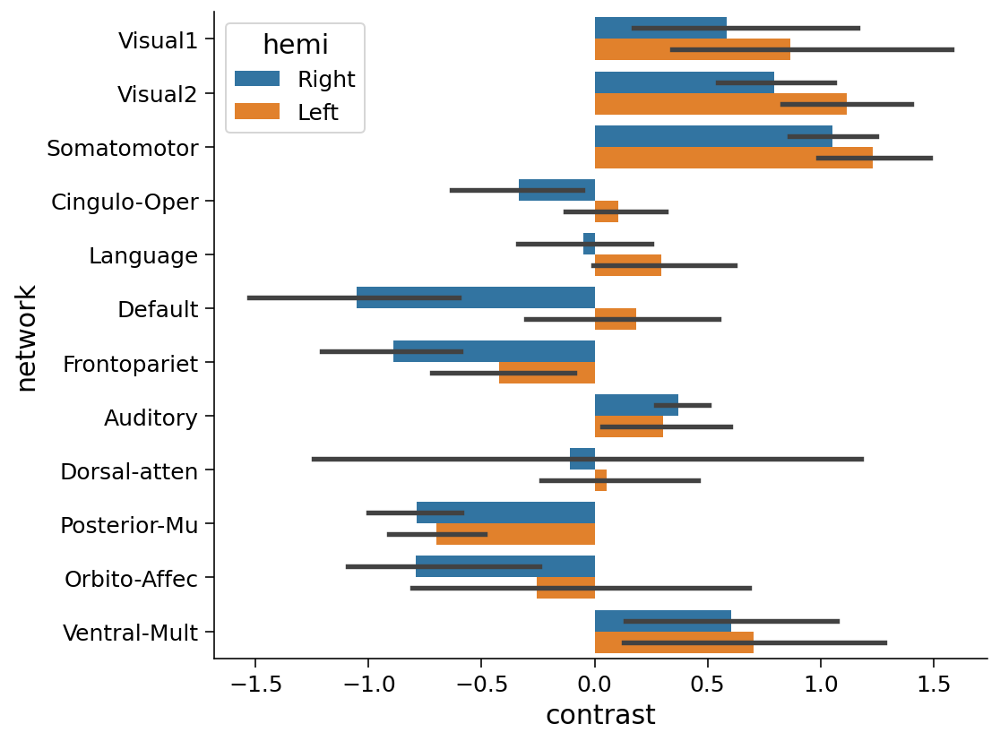

In [ ]:
### reward surprise

# combine network-level data into dataframe
df = pd.DataFrame({'contrast':t_map_context_z[:,4],
                   'network':region_info['network'],
                   'hemi':region_info['hemi']})

# create barplot of contrast by hemisphere, for networks
sns.barplot(y='network', x='contrast', data=df, hue='hemi')
#plt.title('Reward surprise:\nReward trials in loss blocks > Reward trials in reward blocks')
plt.show()

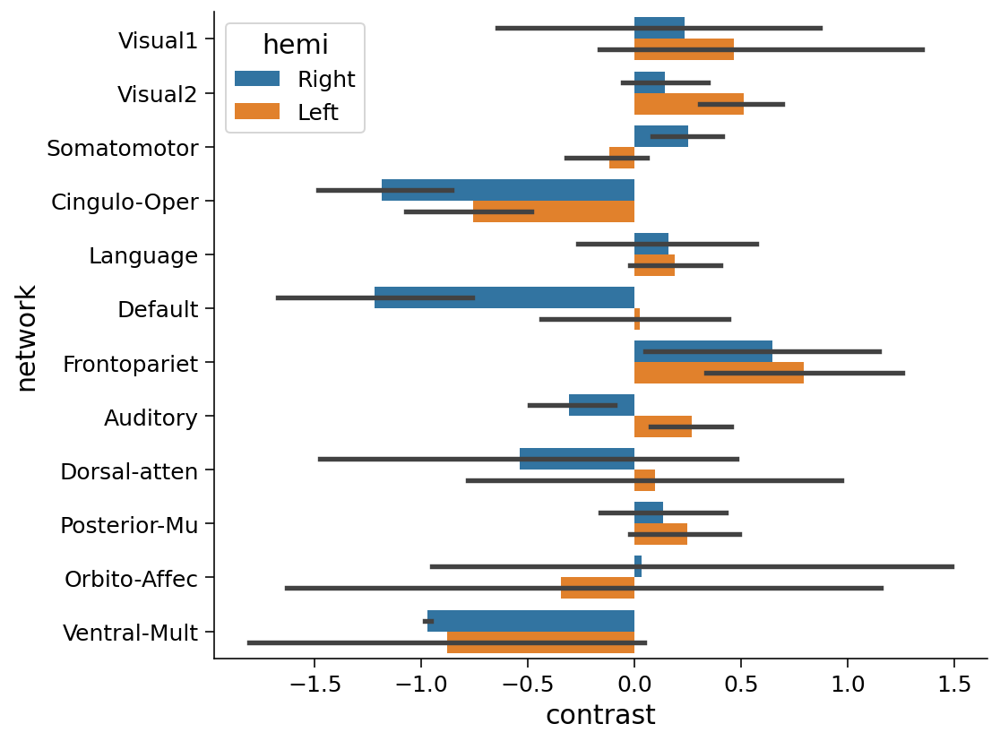

In [ ]:
### loss surprise

# combine network-level data into dataframe
df = pd.DataFrame({'contrast':t_map_context_z[:,5],
                   'network':region_info['network'],
                   'hemi':region_info['hemi']})

# create barplot of contrast by hemisphere, for networks
sns.barplot(y='network', x='contrast', data=df, hue='hemi')
#plt.title('Loss surprise:\nLoss trials in reward blocks > Loss trials in loss blocks')
plt.show()

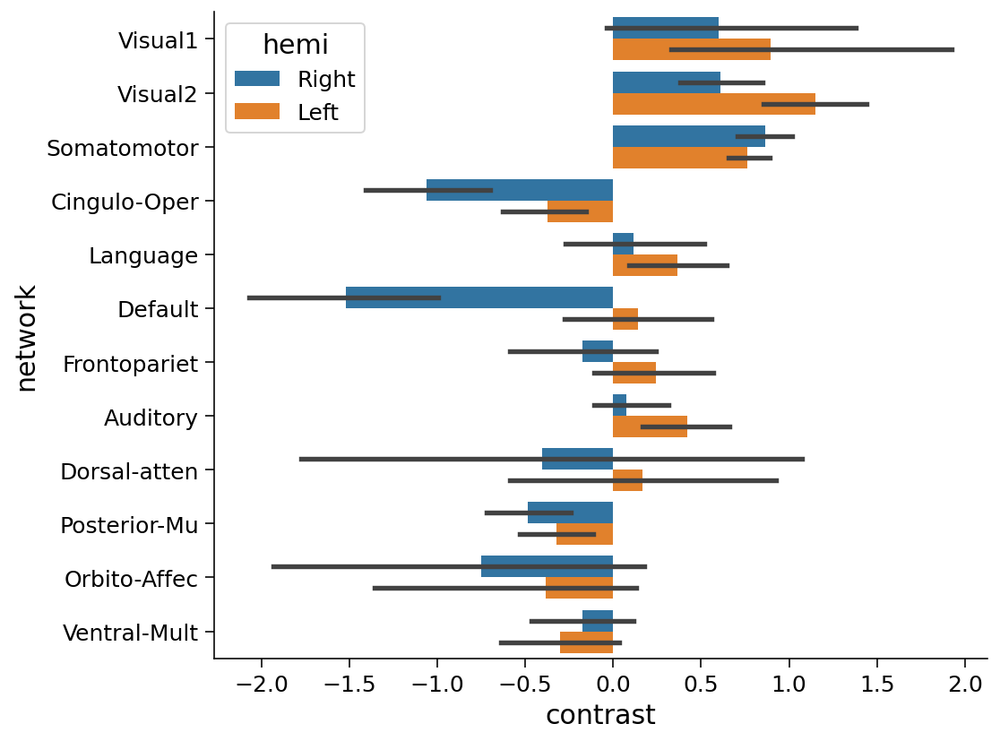

In [ ]:
### surprise

# combine network-level data into dataframe
df = pd.DataFrame({'contrast':t_map_context_z[:,6],
                   'network':region_info['network'],
                   'hemi':region_info['hemi']})

# create barplot of contrast by hemisphere, for networks
sns.barplot(y='network', x='contrast', data=df, hue='hemi')
#plt.title('Surprise: Block-context incongruent vs. incongruent trials')
plt.show()

# No longer used

In [ ]:
# function to load EV file contents to pandas dataframe for trial GLM
def get_ev_dataframe_trials(subject, experiment, run, conditions):
  """load onset files for one subject, experiment and run
  
  Args:
    subject (int): 0-based subject ID to load
    experiment (str) : Name of experiment
    run (int): run number
    conditions (str): List of conditions to include

  Returns
    evs (n_blocks for run x 3 array): Events file for single condition to be formatted for design matrix

  """

  # initialize dataframe to store contents of EV file
  ev_data_all = pd.DataFrame()
  
  task_key = 'tfMRI_'+experiment+'_'+['RL','LR'][run]

  # loop over conditions & extract EV data
  for condition in conditions:
    
    # define EV file
    ev_file  = f"{HCP_DIR}/subjects/{subject}/EVs/{task_key}/{condition}.txt"

    # load EV file contents
    ev_data = pd.read_csv(ev_file, sep="\t", header=None)

    # rename EV data columns to Onset, Duration, Stim (required by NLtools)
    ev_data = ev_data.rename(columns={0: 'Onset', 1: 'Duration'})

    # remove third column
    ev_data = ev_data.drop(columns=[2])

    # add column containing condition info
    rows = len(ev_data.axes[0])
    labels = []
    for i in np.arange(rows):
      labels = np.append(labels, condition + str(i))

    ev_data['Stim'] = labels

    # bind data for this condition
    # to composite dataframe for all conditions
    ev_data_all = ev_data_all.append(ev_data)

    # arrange in order of stim onset
    ev_data_all = ev_data_all.sort_values(by="Onset") 

  return ev_data_all

/usr/local/lib/python3.7/dist-packages/nltools/file_reader.py:141: UserWarning: Computed onsets for loss_event0 are inconsistent with expected values. Please manually verify the outputted Design_Matrix!
  f"Computed onsets for {data.Stim.unique()[i]} are inconsistent with expected values. Please manually verify the outputted Design_Matrix!"
/usr/local/lib/python3.7/dist-packages/nltools/file_reader.py:141: UserWarning: Computed onsets for loss_event1 are inconsistent with expected values. Please manually verify the outputted Design_Matrix!
  f"Computed onsets for {data.Stim.unique()[i]} are inconsistent with expected values. Please manually verify the outputted Design_Matrix!"
/usr/local/lib/python3.7/dist-packages/nltools/file_reader.py:141: UserWarning: Computed onsets for win_event0 are inconsistent with expected values. Please manually verify the outputted Design_Matrix!
  f"Computed onsets for {data.Stim.unique()[i]} are inconsistent with expected values. Please manually verify th

Text(0.5, 0, 'time (s)')

/usr/local/lib/python3.7/dist-packages/google/colab/_event_manager.py:28: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  func(*args, **kwargs)
/usr/local/lib/python3.7/dist-packages/IPython/core/pylabtools.py:125: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations
  fig.canvas.print_figure(bytes_io, **kw)


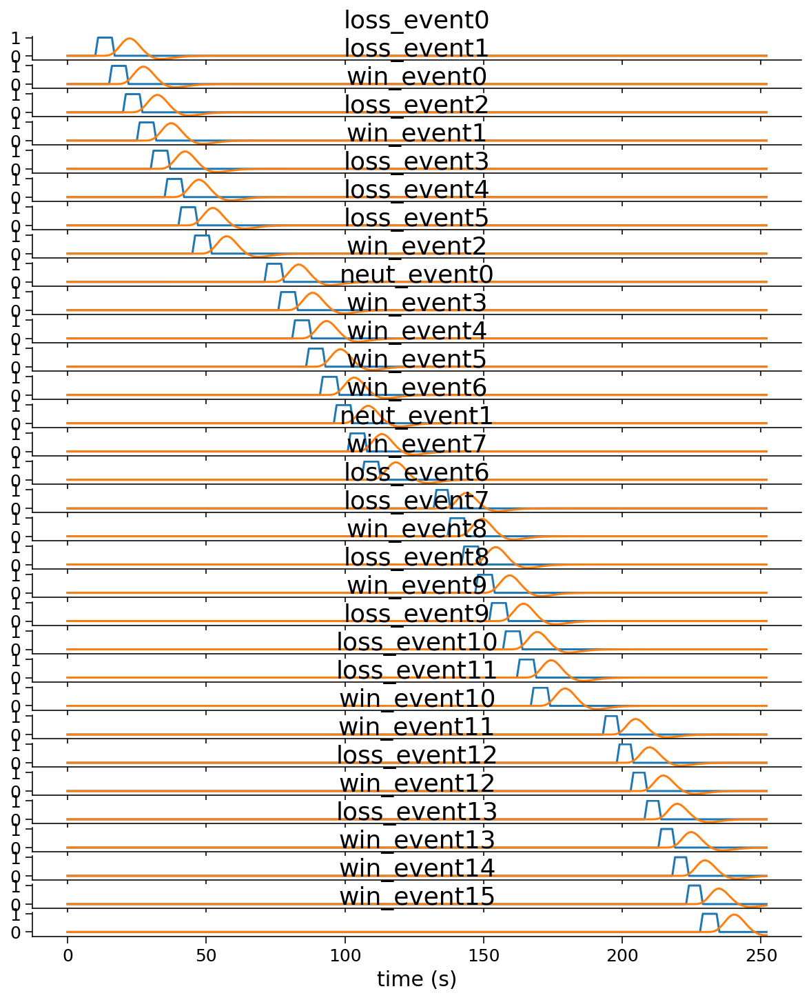

In [ ]:
# create ev data for trial GLM
ev_data = get_ev_dataframe_trials(subject=subject, experiment=experiment, run=1, conditions = ['win_event', 'loss_event', 'neut_event'])
ev_data.head(10)

# create design matrix for trial GLM
design_mat = create_design_matrix(ev_data=ev_data, experiment=experiment, TR=TR)

# arrange columns in reverse alphabetical order
#name_order = ['win_event0', 'win_event1', 'win_event2', 'win_event3',
#              'win_event4', 'win_event5', 'win_event6', 'win_event7',
#              'win_event8', 'win_event9', 'win_event10', 'win_event11',
#              'win_event12', 'win_event13', 'win_event14', 'win_event15',
#              'loss_event0', 'loss_event1', 'loss_event2', 'loss_event3',
#              'loss_event4', 'loss_event5', 'loss_event6', 'loss_event7',
#              'loss_event8', 'loss_event9', 'loss_event10', 'loss_event11',
#              'loss_event12', 'loss_event13']
#design_mat = design_mat[name_order]

# convert design matrix object to array
dm_array = design_mat.to_numpy()

# convolve design matrix with HRF
dm_conv = design_mat.convolve()

# convert convolved dm to array
dm_conv_array = dm_conv.to_numpy()

# initialize figure
plt.figure(figsize=(10,12))

# loop through conditions and plot
for i, condition in enumerate(design_mat.columns):
  plt.subplot(len(design_mat.columns), 1, i+1).set_title(condition)
  plt.plot(dm_array[:,i])
  plt.plot(dm_conv_array[:,i])

plt.xlabel('time (s)')

In [ ]:
# function to compute a beta map across all cortical parcels for trial GLM
def compute_beta_map_trials(subject, experiment, run, design_mat, n_parcels):

  # initialize beta-map as a matrix of zeros
  beta_map = np.zeros((n_parcels, design_mat.shape[1]), dtype=float)

  # we loop over parcels, calculating betas in each case
  for i in np.arange(n_parcels):

    # load timeseries for this parcel
    y = load_single_timeseries(subject=subject, experiment=experiment, run=run)[i]

    # compute betas via OLS
    betas = ordinary_least_squares(design_mat.to_numpy(), y)

    beta_map[i,:] = betas

  return beta_map


# loop over subjects & runs & calculate beta map for each
r = 1
n_trials = 32
n_parcels = 360
beta_map = np.empty(shape = (n_parcels,n_trials,len(subjects)))

for s in [0]:
    
    # load EV file contents to dataframe
    ev_data = get_ev_dataframe_trials(subject=subject, experiment=experiment, run=r, conditions = ['win_event', 'loss_event', 'neut_event'])

    # compute design matrix
    dm = create_design_matrix(ev_data=ev_data, experiment=experiment, TR=TR)

    # convolve design matrix with HRF
    dm_conv = design_mat.convolve()

    # compute beta map
    beta_map[:,:,s] = compute_beta_map_trials(subject=s, experiment=experiment, run=r, design_mat=dm_conv, n_parcels=n_parcels)

/usr/local/lib/python3.7/dist-packages/nltools/file_reader.py:141: UserWarning: Computed onsets for loss_event0 are inconsistent with expected values. Please manually verify the outputted Design_Matrix!
  f"Computed onsets for {data.Stim.unique()[i]} are inconsistent with expected values. Please manually verify the outputted Design_Matrix!"
/usr/local/lib/python3.7/dist-packages/nltools/file_reader.py:141: UserWarning: Computed onsets for loss_event1 are inconsistent with expected values. Please manually verify the outputted Design_Matrix!
  f"Computed onsets for {data.Stim.unique()[i]} are inconsistent with expected values. Please manually verify the outputted Design_Matrix!"
/usr/local/lib/python3.7/dist-packages/nltools/file_reader.py:141: UserWarning: Computed onsets for win_event0 are inconsistent with expected values. Please manually verify the outputted Design_Matrix!
  f"Computed onsets for {data.Stim.unique()[i]} are inconsistent with expected values. Please manually verify th

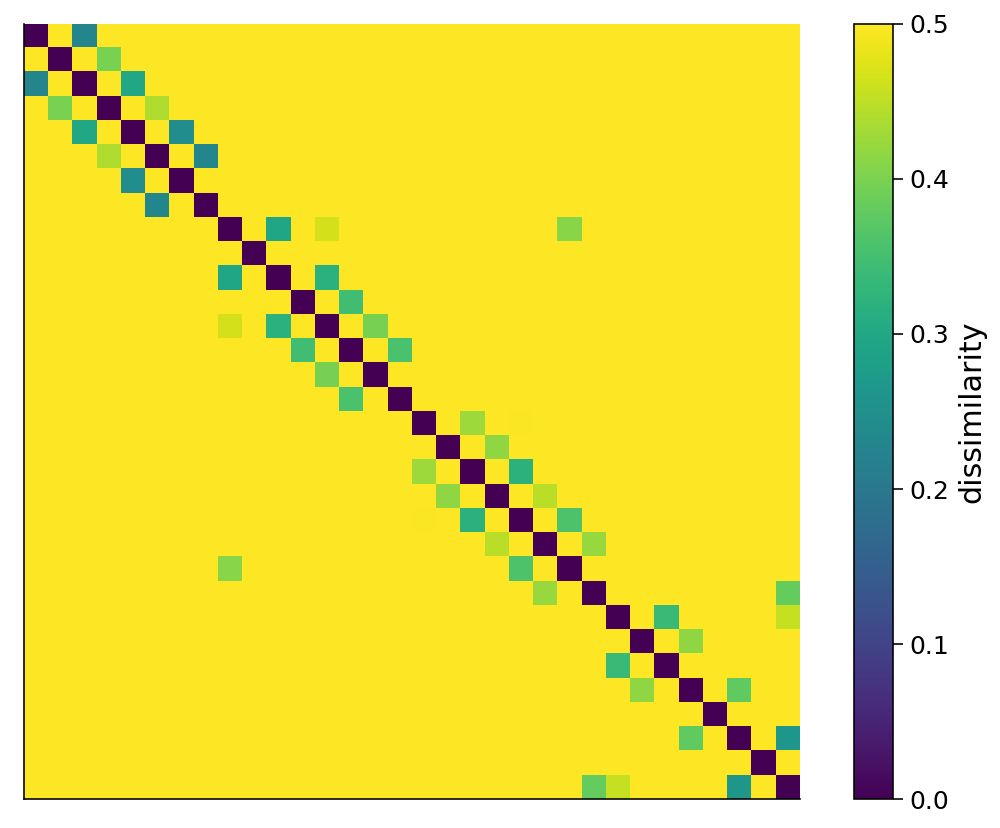

In [ ]:
# average over all participants' beta maps
beta_map_avg = np.mean(beta_map,axis=2)
beta_map_avg.shape # dims are 360 x 30

# create RDM based on trial GLM average-beta-map
zbeta = zscore(beta_map_avg, axis=0)
rdm = 1 - ((1/zbeta.shape[0]) * zbeta.T @ zbeta)

# plot rdm
plot_corr_matrix(rdm)